<a href="https://colab.research.google.com/github/greatshotkid/greatshotkid/blob/main/Unobias003(020924).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Importing dataset from google drive

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Importing the zip file

In [2]:
import zipfile
zip_ref = zipfile.ZipFile("/content/drive/MyDrive/My Dataset.zip", 'r')
zip_ref.extractall("/content/dataset")
zip_ref.close()

## **Importing the required libraries**

In [3]:
!pip install PyMuPDF nltk tensorflow pandas numpy pdfminer.six




   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.5/3.5 MB 42.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.9/15.9 MB 85.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 75.2 MB/s eta 0:00:00


In [4]:
from pdfminer.high_level import extract_text
import os
import numpy as np
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, LSTM, Bidirectional, Dense, Dropout
from sklearn.model_selection import train_test_split
import json
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.metrics import multilabel_confusion_matrix
import seaborn as sns
import nltk
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
import re

In [5]:
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

## **Extracting text from the pdf CVs**

In [7]:
def extract_text_from_pdfs(cv_pdf):
    text_data = []
    for filename in os.listdir(cv_pdf):
        if filename.endswith(".pdf"):
            filepath = os.path.join(cv_pdf, filename)
            try:
                text = extract_text(filepath)
                text_data.append((filename,text))
                #print(f"Successfully processed {filename}")
            except Exception as e:
                print(f"Error processing {filename}: {e}") #prints filename if an error occurs during processing
    return text_data


cv_pdf = '/content/dataset/My Dataset'
cv_texts = extract_text_from_pdfs(cv_pdf)


## Print extract for each pdf

In [ ]:
"""
for i, text in enumerate(cv_texts):
    print(f"\nExtracted Text from Document {i+1}:\n")
    print(text)
"""

Streaming output truncated to the last 5000 lines.
 
 
 
 
  PROJECT: PROPOSED HOUSING DEVELOPMENT, KAJIADO 

CLIENT: PAMORA INVESTMENTS LIMITED 
PROJECT STATUS: ONGOING 

  PROJECT:PROPOSED HOUSING DEVELOPMENT 

CLIENT: URITHI SACCO 
PROJECT STATUS: ONGOING 

  PROJECT: PROPOSED MULTI SPECIALITY HOSPITAL, BUNGOMA 

CLIENT: LIFE CARE HOSPITAL LTD 
PROJECT STATUS: ONGOING 

Hobbies and Interests   
Able to lead and supervise, enjoy reading books, solving puzzles and playing hockey.   

 
 
 
 
 
 
  
  
 
 
 
 
 
 
 
 
 
 
 
 
 
 
REFERENCE 

1.  QS PETER MVOI MWANYUMBA.   

DIRECTOR NYANGE INTEGRATED CONSULTANTS LTD.   
CELLPHONE: +254 723 671040  

2. 

ARCH. TUESDAY NYAKAGO   
DIRECTOR LOCUS STUDIO 
CELLPHONE: +254 710 446137 

3.  NASHON OKOWA 

BEACON AFRICA CONSULTANTS (PROJECT MANAGERS) 
CHAIRMAN: ASSOCIATION OF CONSTRUCTION MANAGERS OF 
KENYA   
CELLPHONE: +254 726 860568 

 
 
 
 
 
 
 
 
 
  
  
  
  
  
  


Extracted Text from Document 3461:

THAMIZ SELVAN.R 
B.E,Civil

##Load keywords

In [8]:
def load_keywords(keyword_file):
    with open(keyword_file, 'r') as file:
        keywords = [line.strip() for line in file.readlines()]
    return keywords


keyword_file = '/content/drive/MyDrive/ITkeywords.txt'
keywords = load_keywords(keyword_file)


##Printing an extract of keywords

In [ ]:
"""
for i, text in enumerate(keywords):
    print(f"\nExtracted Text from Document {i+1}:\n")
    print(text)
"""

'\nfor i, text in enumerate(keywords):\n    print(f"\nExtracted Text from Document {i+1}:\n")\n    print(text)\n'

##Tokenizing and padding sequences

In [9]:

def preprocess_texts(texts, max_num_words=10000, max_seq_length=1000):
    tokenizer = Tokenizer(num_words=max_num_words)
    tokenizer.fit_on_texts(texts)
    sequences = tokenizer.texts_to_sequences(texts)
    padded_sequences = pad_sequences(sequences, maxlen=max_seq_length)
    return padded_sequences, tokenizer


texts = [text for _, text in cv_texts]  # Extract only text from cv_texts
padded_sequences, tokenizer = preprocess_texts(texts)


##Encoding keywords as multi-label targets

In [10]:

def create_keyword_labels(cv_texts, keywords):
    labels = []
    for _, text in cv_texts:
        text = text.lower()
        label = [1 if keyword in text else 0 for keyword in keywords]
        labels.append(label)
    return np.array(labels)


labels = create_keyword_labels(cv_texts, keywords)


##Splitting the data into training and validation set

In [11]:
# Split the data into training (80%) and testing (20%) sets
X_train_full, X_test, y_train_full, y_test = train_test_split(
    padded_sequences, labels, test_size=0.2, random_state=42
)

# Split the training set into training (75%) and validation (25%) sets
X_train, X_val, y_train, y_val = train_test_split(
    X_train_full, y_train_full, test_size=0.25, random_state=42
)

##Building the model

In [12]:
input_dim = 40000  # Based on tokenizer settings
output_dim = len(keywords)  # Number of keywords
input_length = 1000  # Max sequence length used in padding


##Model 15

In [13]:
model_15 = Sequential([
    Embedding(input_dim=input_dim, output_dim=128),
    Bidirectional(LSTM(64, return_sequences=True)),
    Dropout(0.5),
    Bidirectional(LSTM(64)),
    Dense(64, activation = 'relu'),
    Dense(123, activation = 'sigmoid')
    ])



##Compiling the model

In [14]:
model_15.compile(
    loss = 'binary_crossentropy',
    optimizer = 'adam',
    metrics = ['accuracy']
)

## Training and saving the model

In [15]:
history_model_15 = model_15.fit(
    X_train, y_train,
    epochs = 5,
    batch_size=32,
    validation_data=(X_val, y_val),
    verbose = 0

)

#Saving the model
model_15.save('model_15.keras')
with open('history_model_15.json', 'w') as f:
    json.dump(history_model_15.history, f)

##Model summary

In [16]:
model_15.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding (Embedding)                │ (None, 1000, 128)           │       5,120,000 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional (Bidirectional)        │ (None, 1000, 128)           │          98,816 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 1000, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_1 (Bidirectional)      │ (None, 128)                 │          98,816 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 123)                 │           7,995 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 16,001,651 (61.04 MB)

 Trainable params: 5,333,883 (20.35 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 10,667,768 (40.69 MB)

##Reloading the model

In [18]:
model_15 = tf.keras.models.load_model('model_15.keras')
with open('history_model_15.json') as f:
    history_model_15 = json.load(f)

##Plotting the training history

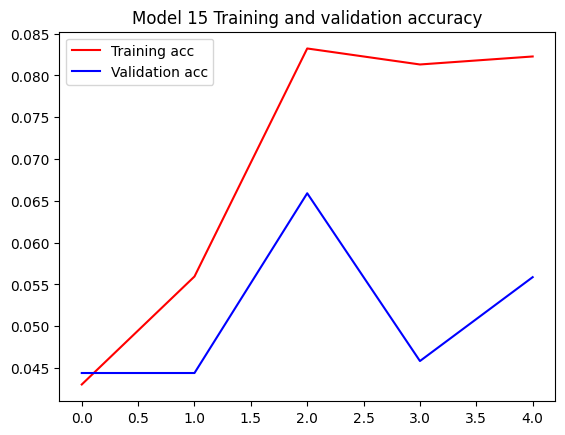

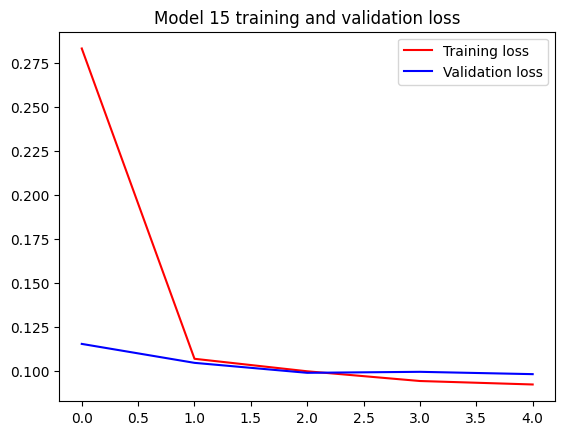

In [19]:
acc = history_model_15['accuracy']
val_acc = history_model_15['val_accuracy']
loss = history_model_15['loss']
val_loss = history_model_15['val_loss']

epochs = range(len(acc))


plt.plot(epochs, acc, 'r', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Model 15 Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Model 15 training and validation loss')
plt.legend()

plt.show()

##Confusion matrix

##Making a prediction

In [20]:
y_pred_prob = model_15.predict(X_test)

22/22 ━━━━━━━━━━━━━━━━━━━━ 3s 94ms/step


##Predictions to binary labels

In [21]:
threshold = 0.85
y_pred = (y_pred_prob > threshold).astype(int)

##Calculating the Matrix

In [22]:
# Compute confusion matrices for each class
conf_matrices = multilabel_confusion_matrix(y_test, y_pred)

# Print confusion matrices
for i, conf_matrix in enumerate(conf_matrices):
    print(f"Confusion Matrix for Keyword {i}:")
    print(conf_matrix)
    print()

Confusion Matrix for Keyword 0:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 1:
[[689   0]
 [  9   0]]

Confusion Matrix for Keyword 2:
[[678   0]
 [ 20   0]]

Confusion Matrix for Keyword 3:
[[632   2]
 [ 63   1]]

Confusion Matrix for Keyword 4:
[[690   0]
 [  8   0]]

Confusion Matrix for Keyword 5:
[[688   0]
 [ 10   0]]

Confusion Matrix for Keyword 6:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 7:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 8:
[[688   0]
 [ 10   0]]

Confusion Matrix for Keyword 9:
[[685   0]
 [ 13   0]]

Confusion Matrix for Keyword 10:
[[695   0]
 [  3   0]]

Confusion Matrix for Keyword 11:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 12:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 13:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 14:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 15:
[[588   0]
 [110   0]]

Confusion Matrix for Keyword 16:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 17:
[[664   

##Visualising the matirx

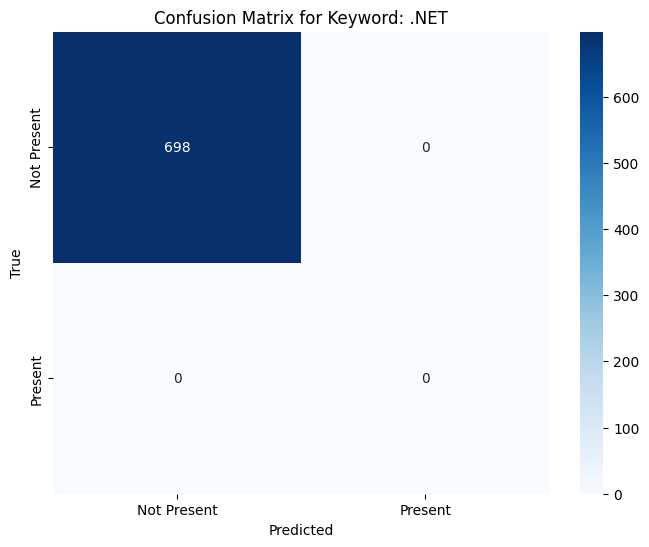

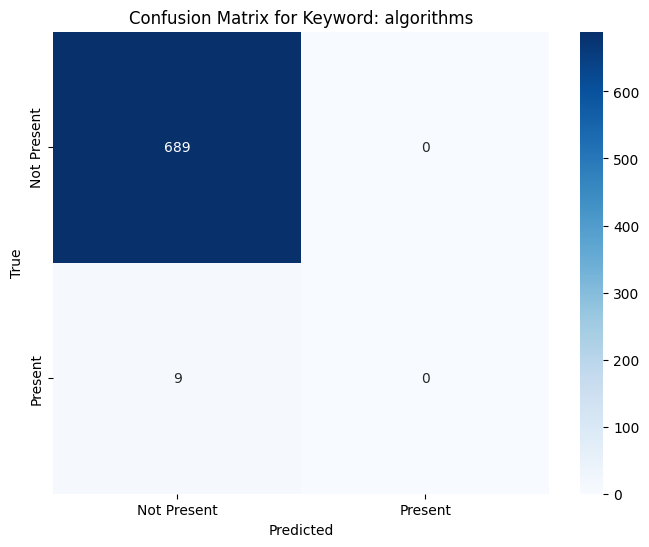

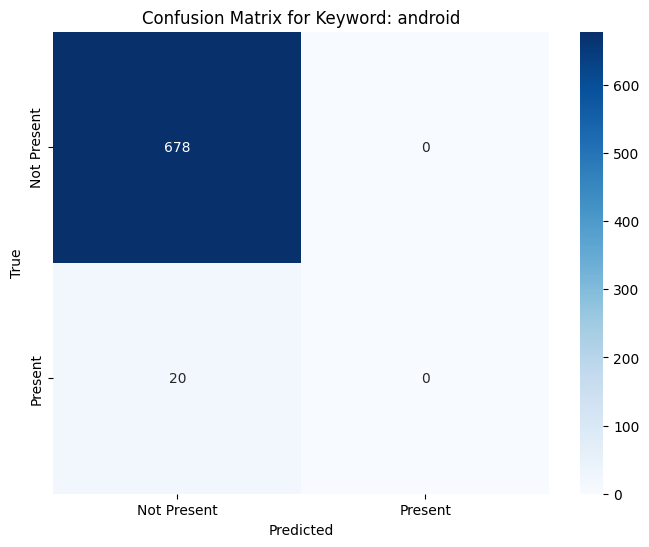

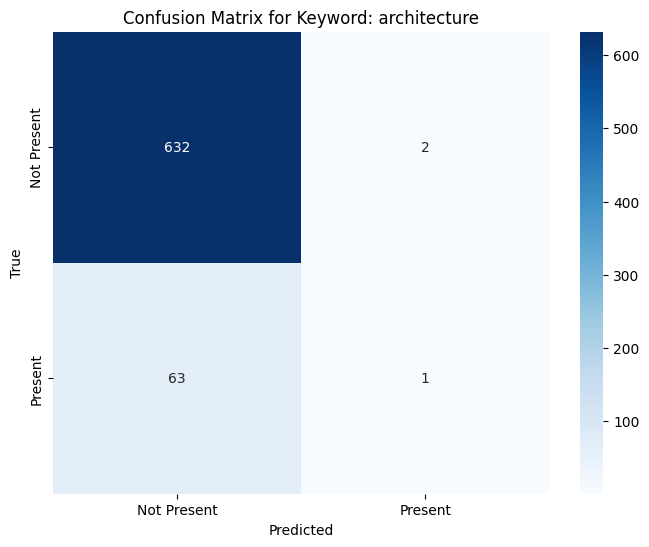

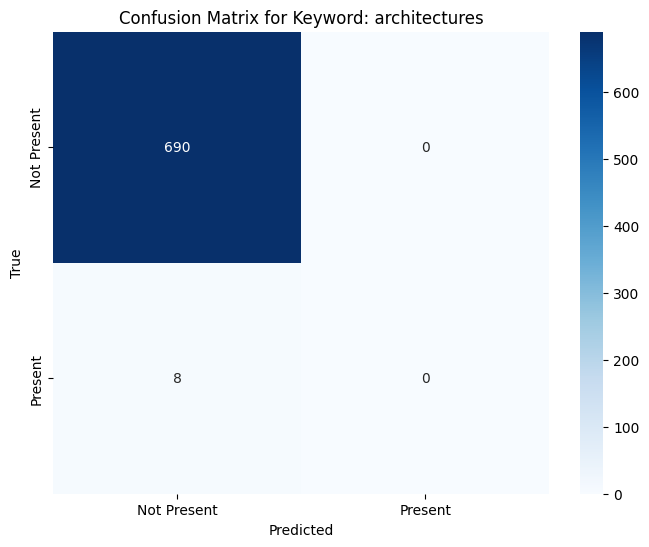

...

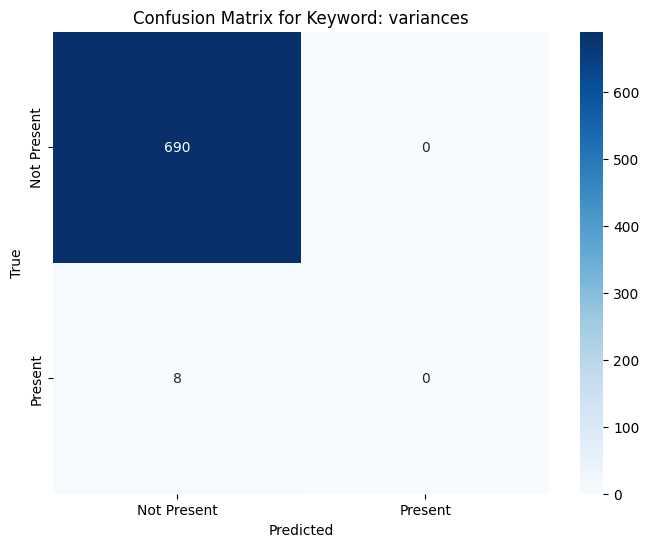

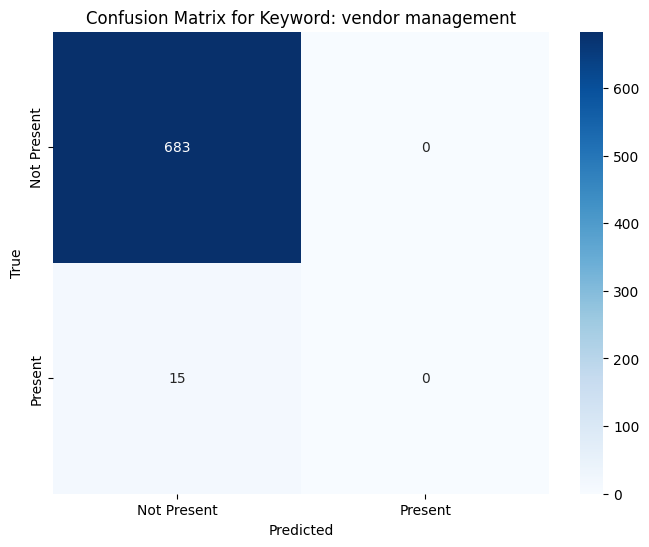

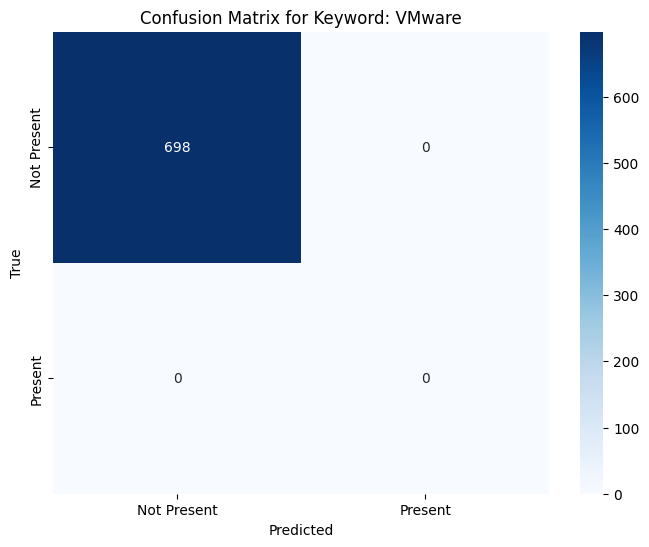

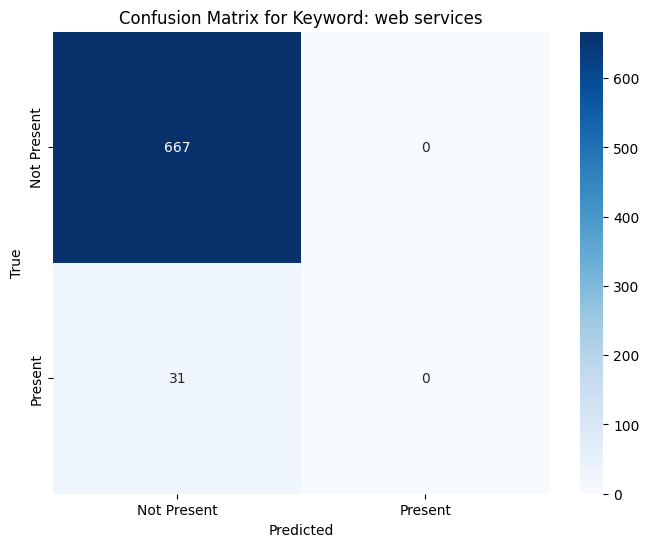

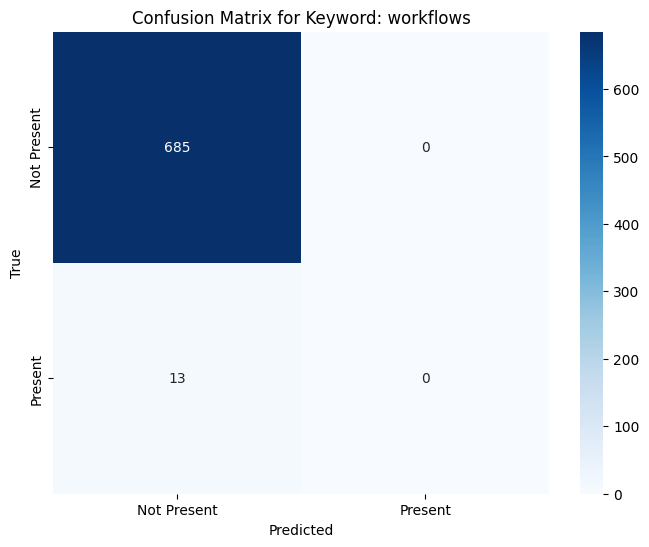

In [23]:
def plot_confusion_matrix(cm, keyword):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=['Not Present', 'Present'],
                yticklabels=['Not Present', 'Present'])
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'Confusion Matrix for Keyword: {keyword}')
    plt.show()

# Plot confusion matrices for each keyword
for i, (conf_matrix, keyword) in enumerate(zip(conf_matrices, keywords)):
    plot_confusion_matrix(conf_matrix, keyword)

##Matching keywords

In [24]:
# Function to find matched and unmatched keywords in each CV
def check_keywords_in_cv(text, keywords):
    # Ensure text and keywords are strings
    text = str(text)
    keywords = [str(keyword) for keyword in keywords]

    matched = [keyword for keyword in keywords if keyword.lower() in text.lower()]
    unmatched = [keyword for keyword in keywords if keyword.lower() not in text.lower()]
    return matched, unmatched

##Check cv text in each test set

In [25]:
for i, text in enumerate(cv_texts[:len(X_test)]):  # Limit to the test set size
    matched, unmatched = check_keywords_in_cv(text, keywords)
    print(f"\nCV {i+1}:")
    print(f"Matched Keywords: {matched}")
    print(f"Unmatched Keywords: {unmatched}")


CV 1:
Matched Keywords: ['certification', 'LAN', 'OS', 'SAS', 'UI']
Unmatched Keywords: ['.NET', 'algorithms', 'android', 'architecture', 'architectures', 'audio', 'AutoCAD', 'AWS', 'big data', 'business analysis', 'business continuity', 'C (programming language)', 'C#', 'C++', 'CAD', 'Cisco', 'cloud', 'compliance', 'computer applications', 'computer science', 'controls', 'CSS', 'D (programming language)', 'data center', 'data collection', 'data entry', 'data management', 'database', 'datasets', 'design', 'development activities', 'digital marketing', 'digital media', 'distribution', 'DNS', 'ecommerce', 'e-commerce', 'end user', 'experimental', 'experiments', 'frameworks', 'front-end', 'GIS', 'graphic design', 'hardware', 'HTML5', 'I-DEAS', 'information management', 'information security', 'information technology', 'intranet', 'iOS', 'iPhone', 'IT infrastructure', 'ITIL', 'Java', 'Javascript', 'JIRA', 'licensing', 'Linux', 'machine learning', 'MATLAB', 'matrix', 'mechanical engineerin

##Model 16 doubling epochs

In [26]:
model_16 = Sequential([
    Embedding(input_dim=input_dim, output_dim=128),
    Bidirectional(LSTM(64, return_sequences=True)),
    Dropout(0.5),
    Bidirectional(LSTM(64)),
    Dense(64, activation = 'relu'),
    Dense(123, activation = 'sigmoid')
    ])


##Compiling the model

In [27]:
model_16.compile(
    loss = 'binary_crossentropy',
    optimizer = 'adam',
    metrics = ['accuracy']
)

##Training and saving the model

In [28]:
history_model_16 = model_16.fit(
    X_train, y_train,
    epochs = 10,
    batch_size=32,
    validation_data=(X_val, y_val),
    verbose=0
)

#Saving the model
model_16.save('model_16.keras')
with open('history_model_16.json', 'w') as f:
    json.dump(history_model_16.history, f)

##Model summary

In [29]:
model_16.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding_1 (Embedding)              │ (None, 1000, 128)           │       5,120,000 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_2 (Bidirectional)      │ (None, 1000, 128)           │          98,816 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 1000, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_3 (Bidirectional)      │ (None, 128)                 │          98,816 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 123)                 │           7,995 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 16,001,651 (61.04 MB)

 Trainable params: 5,333,883 (20.35 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 10,667,768 (40.69 MB)

##Reloading the model

In [31]:
model_16 = tf.keras.models.load_model('model_16.keras')
with open('history_model_16.json') as f:
    history_model_16 = json.load(f)

##Plotting the training

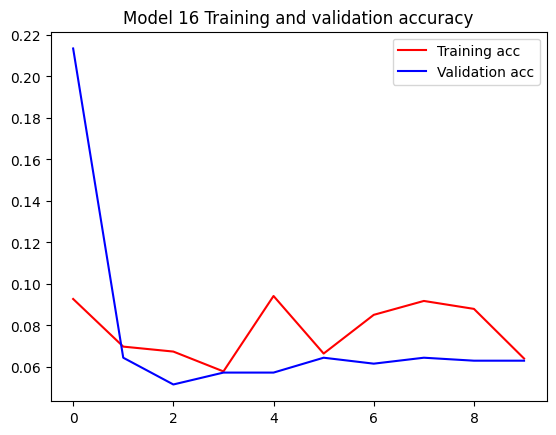

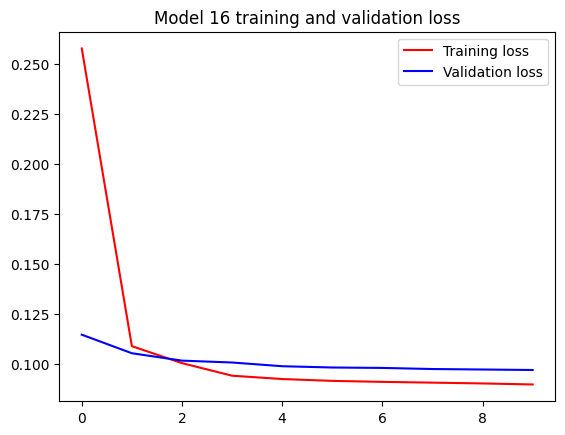

In [32]:
acc = history_model_16['accuracy']
val_acc = history_model_16['val_accuracy']
loss = history_model_16['loss']
val_loss = history_model_16['val_loss']

epochs = range(len(acc))


plt.plot(epochs, acc, 'r', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Model 16 Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Model 16 training and validation loss')
plt.legend()

plt.show()

##Making a prediction

In [33]:
y_pred_prob = model_16.predict(X_test)

22/22 ━━━━━━━━━━━━━━━━━━━━ 3s 92ms/step


##Predictions to binary

In [34]:
threshold = 0.85
y_pred = (y_pred_prob > threshold).astype(int)

##Calculating the matrix

In [35]:
# Compute confusion matrices for each class
conf_matrices = multilabel_confusion_matrix(y_test, y_pred)

# Print confusion matrices
for i, conf_matrix in enumerate(conf_matrices):
    print(f"Confusion Matrix for Keyword {i}:")
    print(conf_matrix)
    print()

Confusion Matrix for Keyword 0:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 1:
[[689   0]
 [  9   0]]

Confusion Matrix for Keyword 2:
[[678   0]
 [ 20   0]]

Confusion Matrix for Keyword 3:
[[632   2]
 [ 55   9]]

Confusion Matrix for Keyword 4:
[[690   0]
 [  8   0]]

Confusion Matrix for Keyword 5:
[[688   0]
 [ 10   0]]

Confusion Matrix for Keyword 6:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 7:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 8:
[[688   0]
 [ 10   0]]

Confusion Matrix for Keyword 9:
[[685   0]
 [ 13   0]]

Confusion Matrix for Keyword 10:
[[695   0]
 [  3   0]]

Confusion Matrix for Keyword 11:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 12:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 13:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 14:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 15:
[[588   0]
 [110   0]]

Confusion Matrix for Keyword 16:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 17:
[[664   

##Visualising the matrix

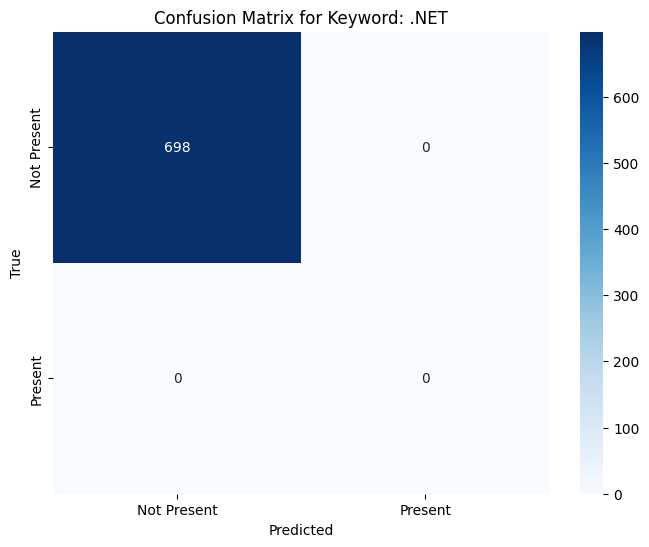

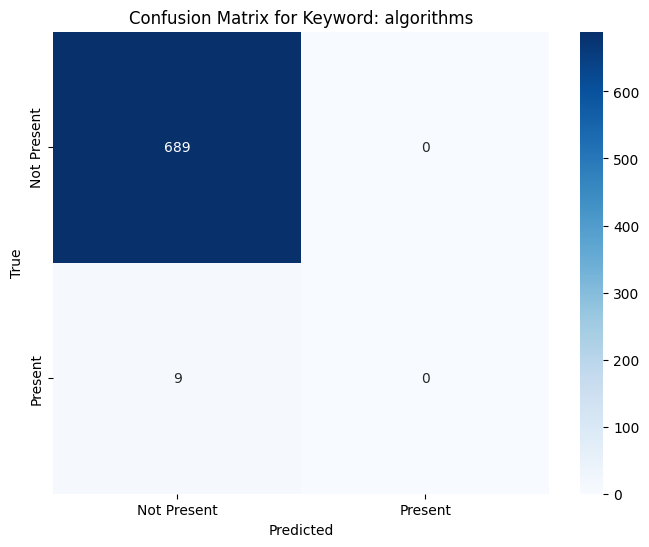

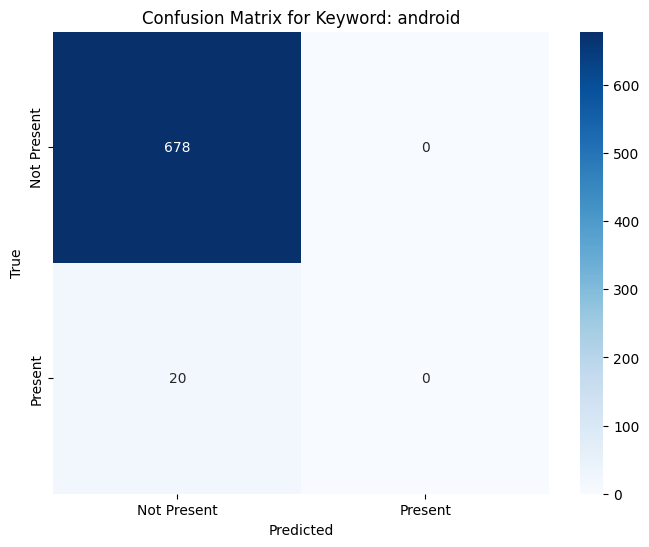

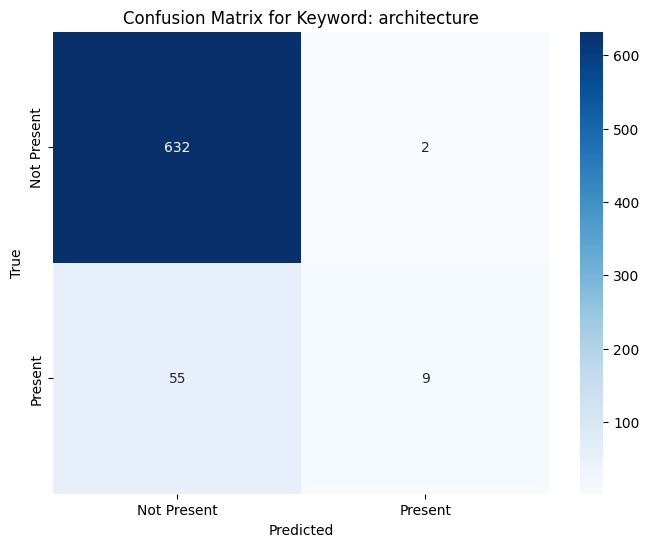

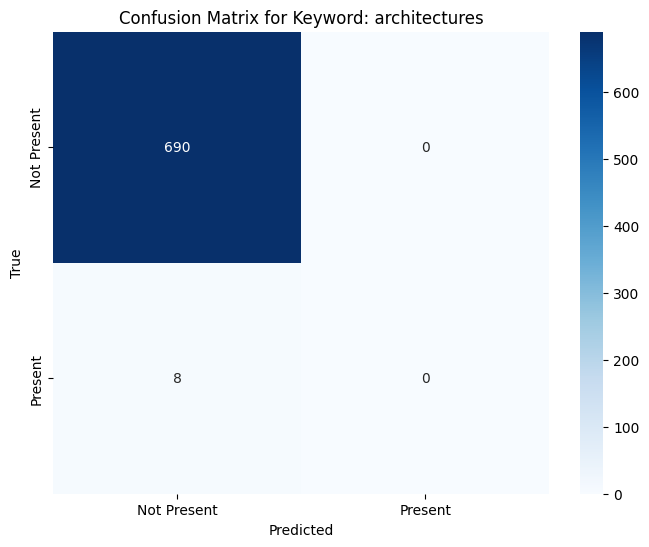

...

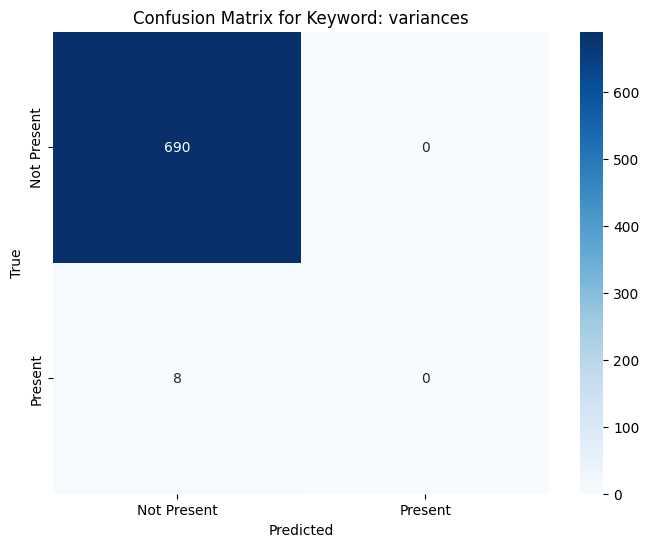

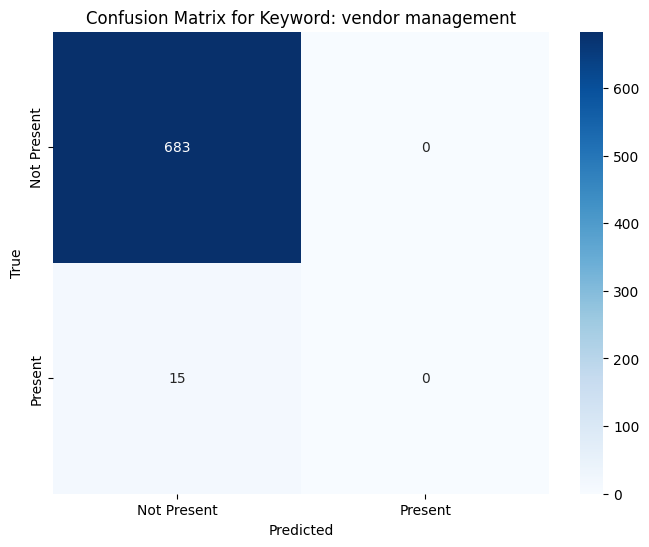

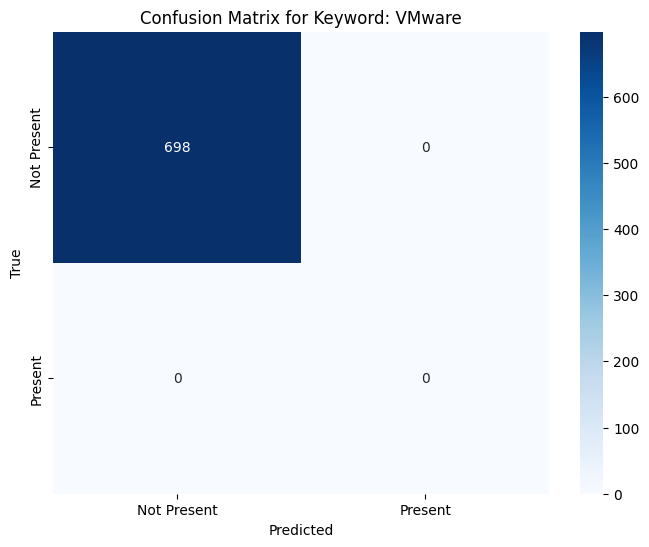

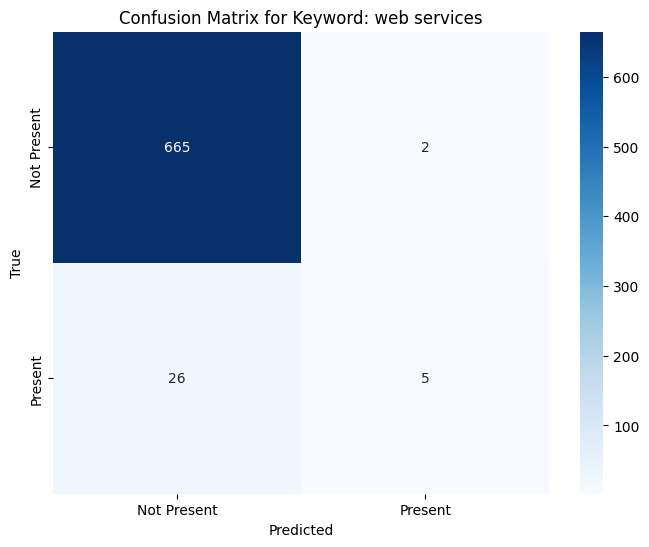

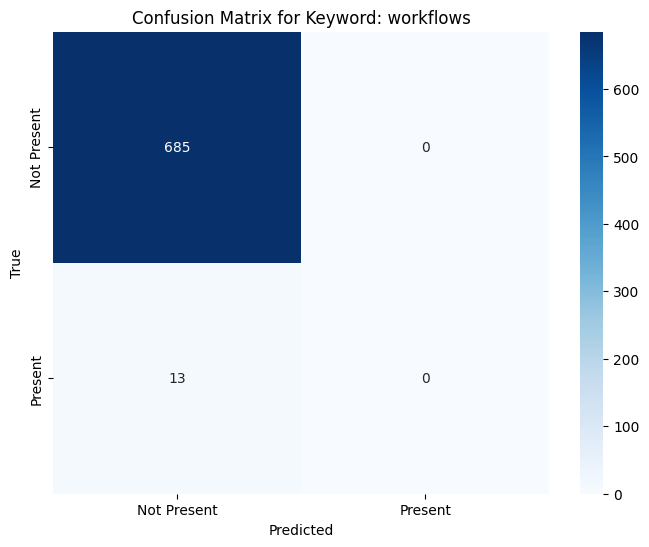

In [36]:
def plot_confusion_matrix(cm, keyword):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=['Not Present', 'Present'],
                yticklabels=['Not Present', 'Present'])
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'Confusion Matrix for Keyword: {keyword}')
    plt.show()

# Plot confusion matrices for each keyword
for i, (conf_matrix, keyword) in enumerate(zip(conf_matrices, keywords)):
    plot_confusion_matrix(conf_matrix, keyword)

##Evaluating the model

In [37]:
model_15.evaluate(X_test, y_test)
model_16.evaluate(X_test, y_test)

22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.0452 - loss: 0.0978
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 69ms/step - accuracy: 0.0679 - loss: 0.0972


[0.09825022518634796, 0.05300859734416008]

##Model 17 - doubling epochs to 20

In [38]:
model_17 = Sequential([
    Embedding(input_dim=input_dim, output_dim=128),
    Bidirectional(LSTM(64, return_sequences=True)),
    Dropout(0.5),
    Bidirectional(LSTM(64)),
    Dense(64, activation = 'relu'),
    Dense(123, activation = 'sigmoid')
    ])


## Compiling the model

In [39]:
model_17.compile(
    loss = 'binary_crossentropy',
    optimizer = 'adam',
    metrics = ['accuracy']
)

##Training and saving the model

In [40]:
history_model_17 = model_17.fit(
    X_train, y_train,
    epochs = 20,
    batch_size=32,
    validation_data=(X_val, y_val),
    verbose = 0
)

#Saving the model
model_17.save('model_17.keras')
with open('history_model_17.json', 'w') as f:
    json.dump(history_model_17.history, f)

Epoch 1/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 13s 146ms/step - accuracy: 0.0122 - loss: 0.4383 - val_accuracy: 0.0645 - val_loss: 0.1149
Epoch 2/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 9s 136ms/step - accuracy: 0.0808 - loss: 0.1131 - val_accuracy: 0.0645 - val_loss: 0.1065
Epoch 3/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 9s 130ms/step - accuracy: 0.0638 - loss: 0.1034 - val_accuracy: 0.0444 - val_loss: 0.1044
Epoch 4/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 11s 139ms/step - accuracy: 0.0758 - loss: 0.0998 - val_accuracy: 0.0645 - val_loss: 0.0976
Epoch 5/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 11s 148ms/step - accuracy: 0.0803 - loss: 0.0955 - val_accuracy: 0.0645 - val_loss: 0.0970
Epoch 6/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 13s 193ms/step - accuracy: 0.0652 - loss: 0.0924 - val_accuracy: 0.0688 - val_loss: 0.0968
Epoch 7/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 21s 199ms/step - accuracy: 0.0957 - loss: 0.0897 - val_accuracy: 0.1074 - val_loss: 0.0952
Epoch 8/20
66/66 ━━━━━━━━━━━━━━━━━━━━ 16s 129ms/step - accuracy: 0.0770 - loss: 0.0867 - val_accura

##Model summary

In [41]:
model_17.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding_2 (Embedding)              │ (None, 1000, 128)           │       5,120,000 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_4 (Bidirectional)      │ (None, 1000, 128)           │          98,816 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 1000, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_5 (Bidirectional)      │ (None, 128)                 │          98,816 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 123)                 │           7,995 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 16,001,651 (61.04 MB)

 Trainable params: 5,333,883 (20.35 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 10,667,768 (40.69 MB)

##Reloading the model

In [42]:
model_17 = tf.keras.models.load_model('model_17.keras')
with open('history_model_17.json') as f:
    history_model_17 = json.load(f)

##Plotting the training

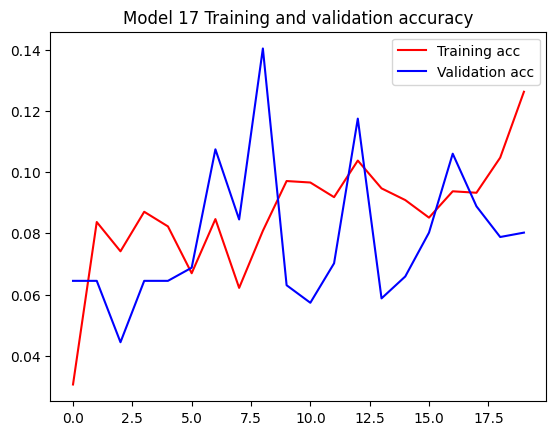

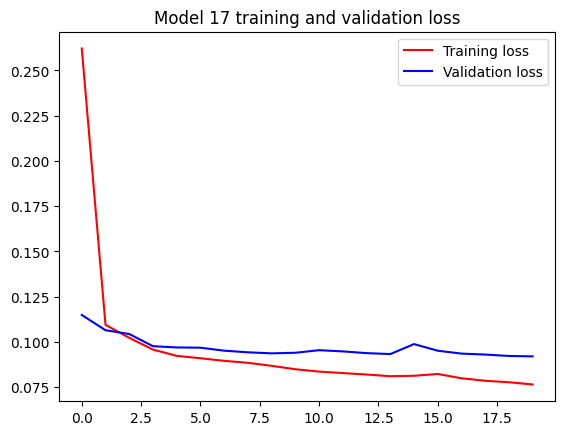

In [43]:
acc = history_model_17['accuracy']
val_acc = history_model_17['val_accuracy']
loss = history_model_17['loss']
val_loss = history_model_17['val_loss']

epochs = range(len(acc))


plt.plot(epochs, acc, 'r', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Model 17 Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Model 17 training and validation loss')
plt.legend()

plt.show()

##Predictions

In [45]:
y_pred_prob = model_17.predict(X_test)
threshold = 0.85
y_pred = (y_pred_prob > threshold).astype(int)

22/22 ━━━━━━━━━━━━━━━━━━━━ 4s 122ms/step


##Calculating the matrix

In [46]:
# Compute confusion matrices for each class
conf_matrices = multilabel_confusion_matrix(y_test, y_pred)

# Print confusion matrices
for i, conf_matrix in enumerate(conf_matrices):
    print(f"Confusion Matrix for Keyword {i}:")
    print(conf_matrix)
    print()

Confusion Matrix for Keyword 0:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 1:
[[689   0]
 [  9   0]]

Confusion Matrix for Keyword 2:
[[678   0]
 [ 20   0]]

Confusion Matrix for Keyword 3:
[[632   2]
 [ 50  14]]

Confusion Matrix for Keyword 4:
[[690   0]
 [  8   0]]

Confusion Matrix for Keyword 5:
[[688   0]
 [ 10   0]]

Confusion Matrix for Keyword 6:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 7:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 8:
[[688   0]
 [ 10   0]]

Confusion Matrix for Keyword 9:
[[685   0]
 [ 13   0]]

Confusion Matrix for Keyword 10:
[[695   0]
 [  3   0]]

Confusion Matrix for Keyword 11:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 12:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 13:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 14:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 15:
[[588   0]
 [110   0]]

Confusion Matrix for Keyword 16:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 17:
[[664   

##Visualising the matrix

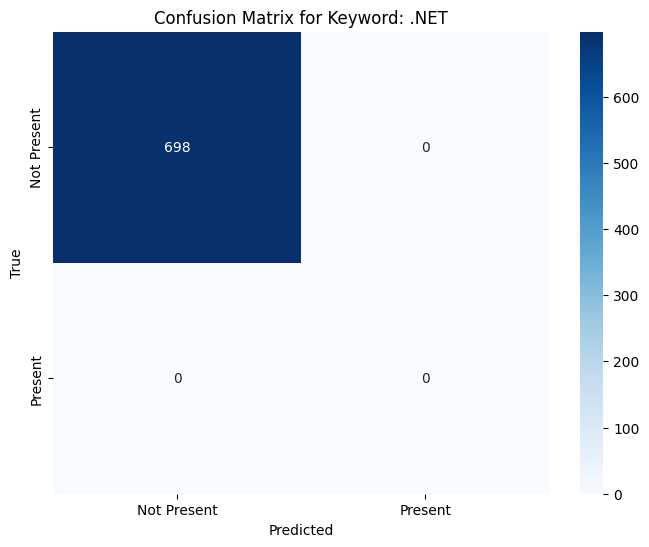

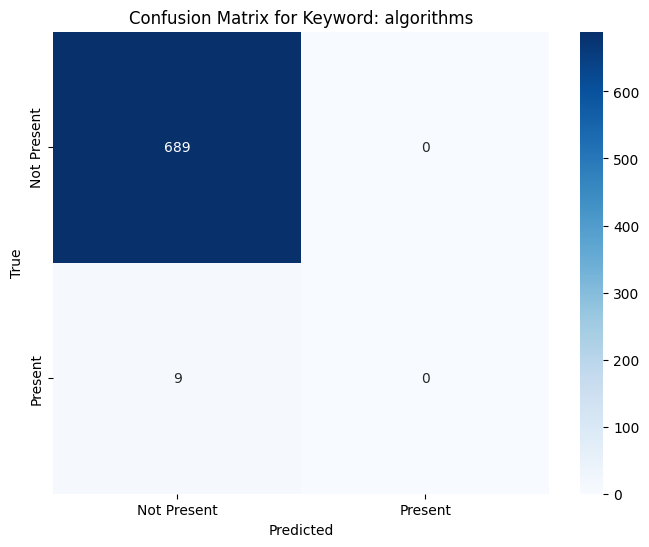

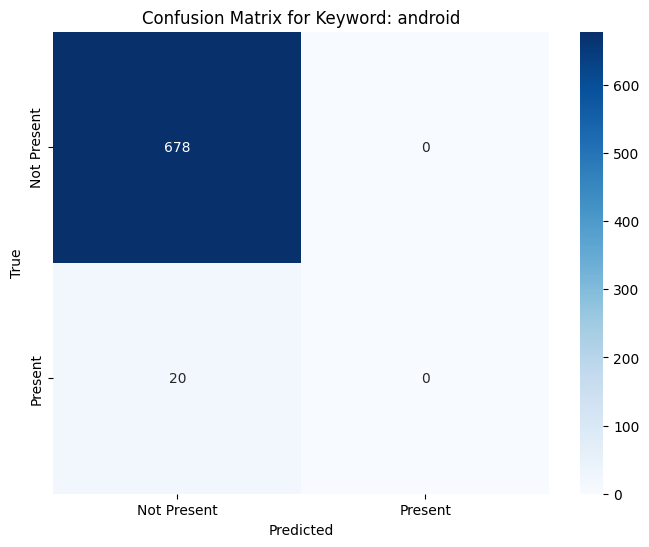

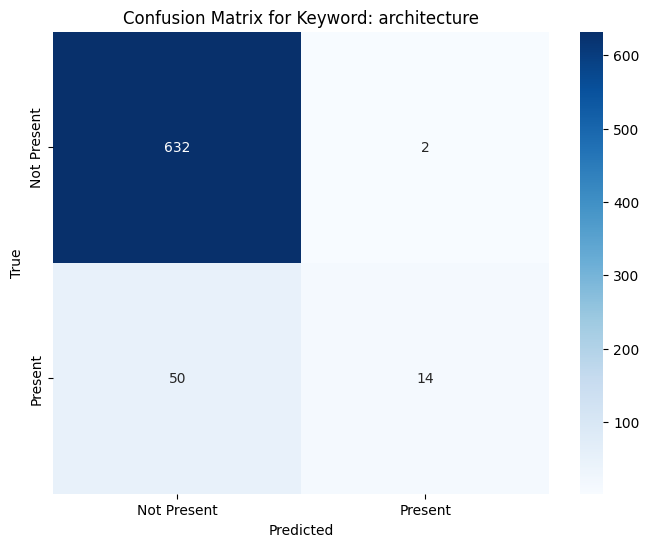

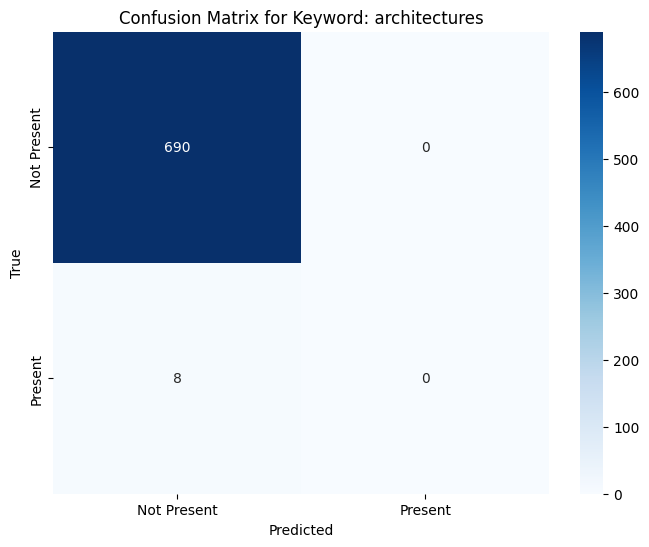

...

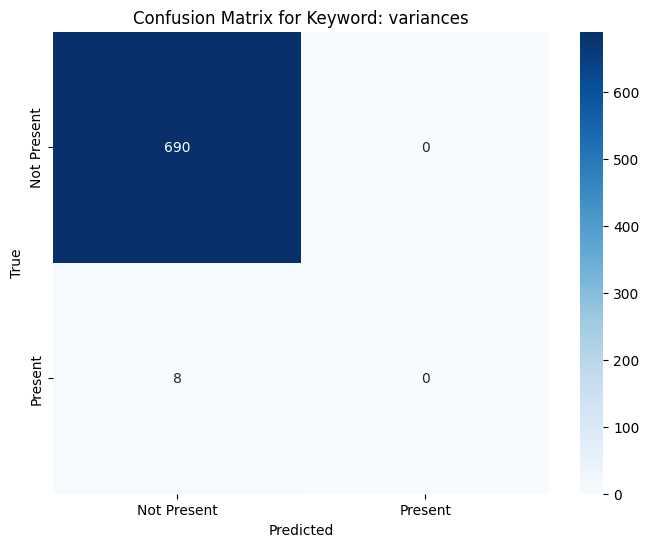

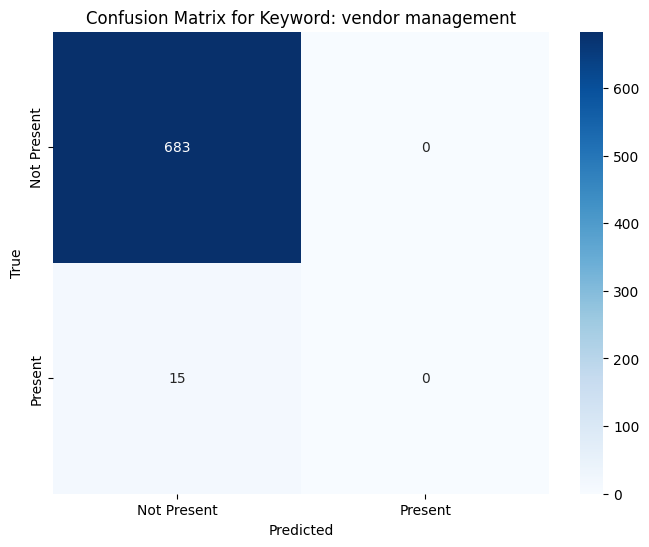

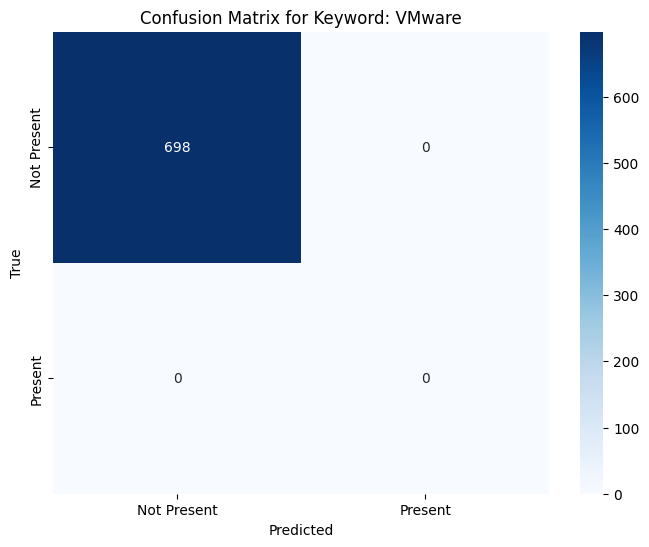

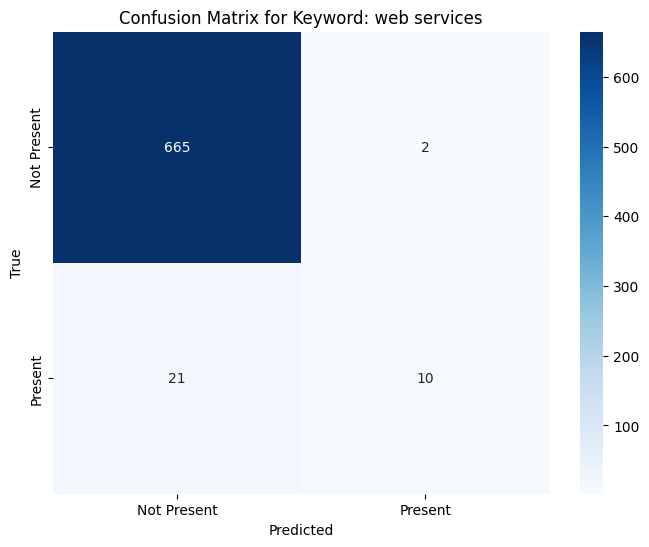

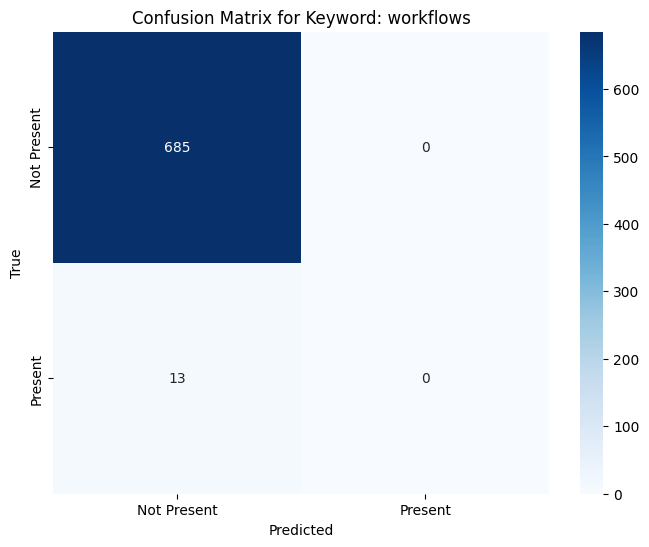

In [47]:
def plot_confusion_matrix(cm, keyword):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=['Not Present', 'Present'],
                yticklabels=['Not Present', 'Present'])
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'Confusion Matrix for Keyword: {keyword}')
    plt.show()

# Plot confusion matrices for each keyword
for i, (conf_matrix, keyword) in enumerate(zip(conf_matrices, keywords)):
    plot_confusion_matrix(conf_matrix, keyword)

##Evaluating the model

In [48]:
model_17.evaluate(X_test, y_test)

22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.0705 - loss: 0.0908


[0.09162778407335281, 0.06303724646568298]

##Model 18 doubling epochs to 40

In [50]:
model_18 = Sequential([
    Embedding(input_dim=input_dim, output_dim=128),
    Bidirectional(LSTM(64, return_sequences=True)),
    Dropout(0.5),
    Bidirectional(LSTM(64)),
    Dense(64, activation = 'relu'),
    Dense(123, activation = 'sigmoid')
    ])


##Compiling the model

In [51]:
model_18.compile(
    loss = 'binary_crossentropy',
    optimizer = 'adam',
    metrics = ['accuracy']
)

##Training and saving the model

In [52]:
history_model_18 = model_18.fit(
    X_train, y_train,
    epochs = 40,
    batch_size=32,
    validation_data=(X_val, y_val),
    verbose=0
)

#Saving the model
model_18.save('model_18.keras')
with open('history_model_18.json', 'w') as f:
    json.dump(history_model_18.history, f)

##Model summary

In [53]:
model_18.summary()

Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding_4 (Embedding)              │ (None, 1000, 128)           │       5,120,000 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_8 (Bidirectional)      │ (None, 1000, 128)           │          98,816 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 1000, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_9 (Bidirectional)      │ (None, 128)                 │          98,816 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 123)                 │           7,995 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 16,001,651 (61.04 MB)

 Trainable params: 5,333,883 (20.35 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 10,667,768 (40.69 MB)

##Reloading the model

In [54]:
model_18 = tf.keras.models.load_model('model_18.keras')
with open('history_model_18.json') as f:
    history_model_18 = json.load(f)

##plotting the training

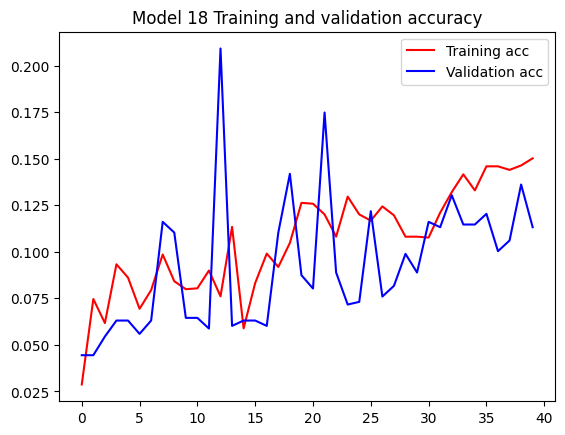

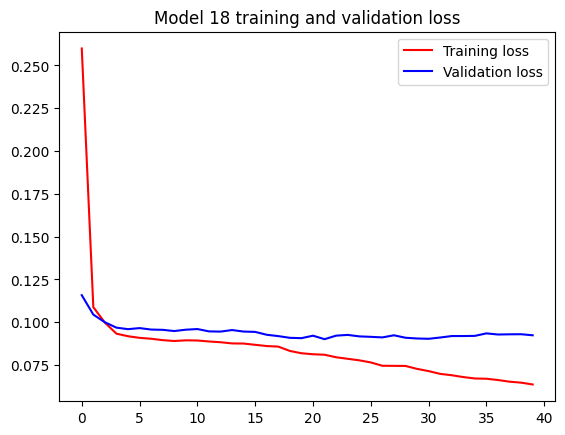

In [55]:
acc = history_model_18['accuracy']
val_acc = history_model_18['val_accuracy']
loss = history_model_18['loss']
val_loss = history_model_18['val_loss']

epochs = range(len(acc))


plt.plot(epochs, acc, 'r', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Model 18 Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Model 18 training and validation loss')
plt.legend()

plt.show()

##Predictions

In [56]:
y_pred_prob = model_18.predict(X_test)
threshold = 0.85
y_pred = (y_pred_prob > threshold).astype(int)

22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 62ms/step


##Creating the matrix

In [57]:
# Compute confusion matrices for each class
conf_matrices = multilabel_confusion_matrix(y_test, y_pred)

# Print confusion matrices
for i, conf_matrix in enumerate(conf_matrices):
    print(f"Confusion Matrix for Keyword {i}:")
    print(conf_matrix)
    print()

Confusion Matrix for Keyword 0:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 1:
[[689   0]
 [  9   0]]

Confusion Matrix for Keyword 2:
[[678   0]
 [ 20   0]]

Confusion Matrix for Keyword 3:
[[630   4]
 [ 40  24]]

Confusion Matrix for Keyword 4:
[[690   0]
 [  8   0]]

Confusion Matrix for Keyword 5:
[[688   0]
 [ 10   0]]

Confusion Matrix for Keyword 6:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 7:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 8:
[[688   0]
 [ 10   0]]

Confusion Matrix for Keyword 9:
[[684   1]
 [ 13   0]]

Confusion Matrix for Keyword 10:
[[695   0]
 [  3   0]]

Confusion Matrix for Keyword 11:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 12:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 13:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 14:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 15:
[[588   0]
 [109   1]]

Confusion Matrix for Keyword 16:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 17:
[[662   

##Visualising the matrix

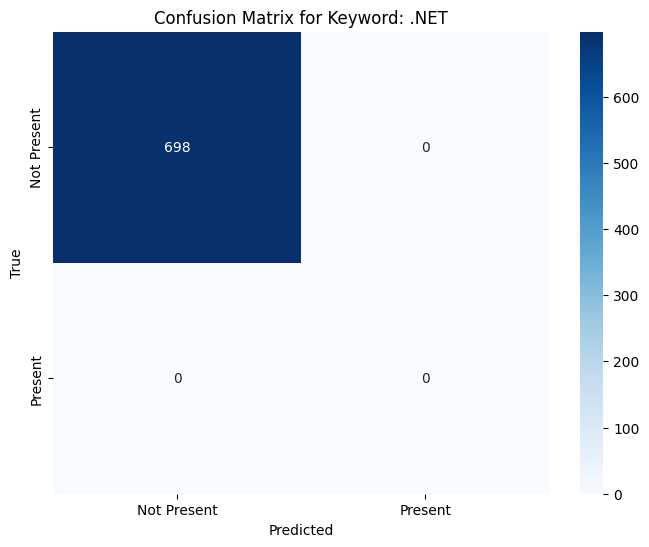

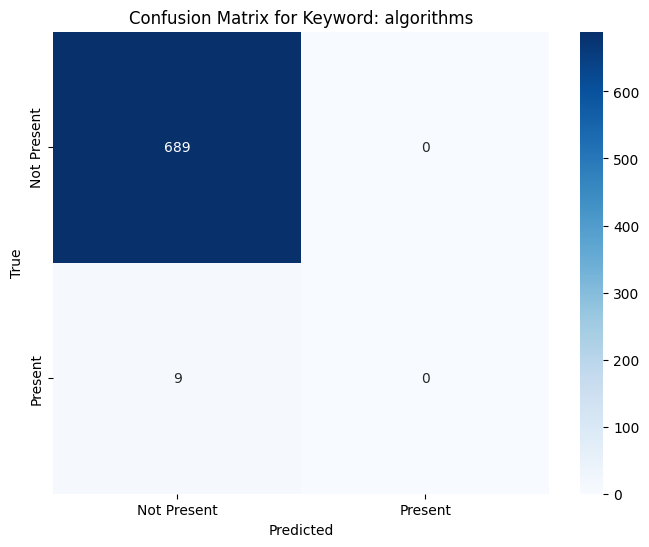

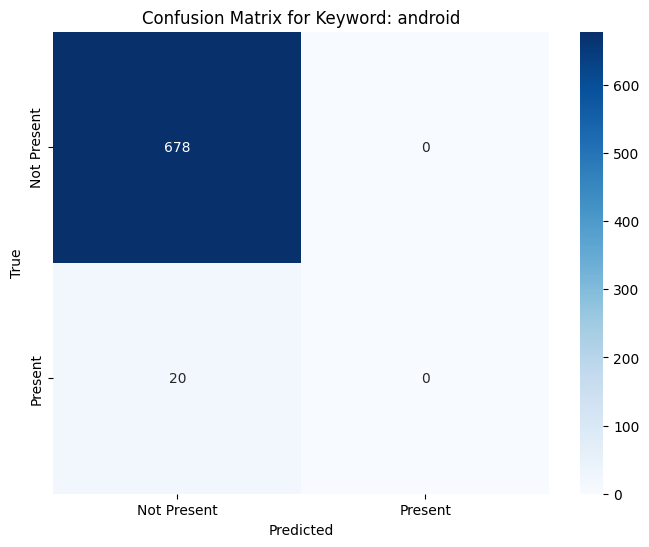

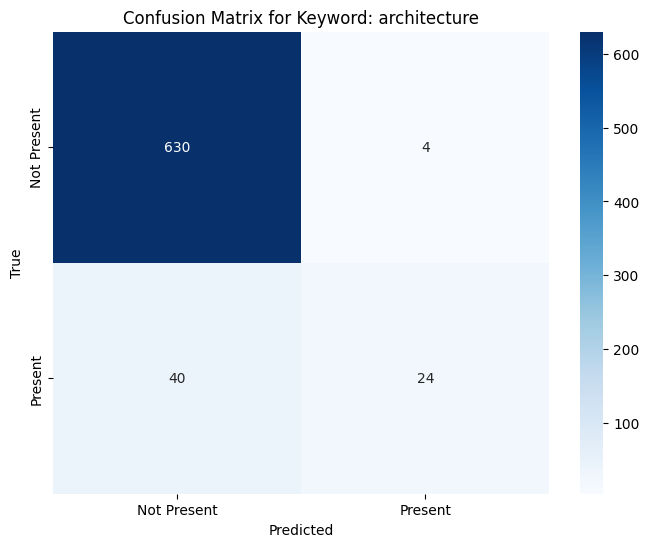

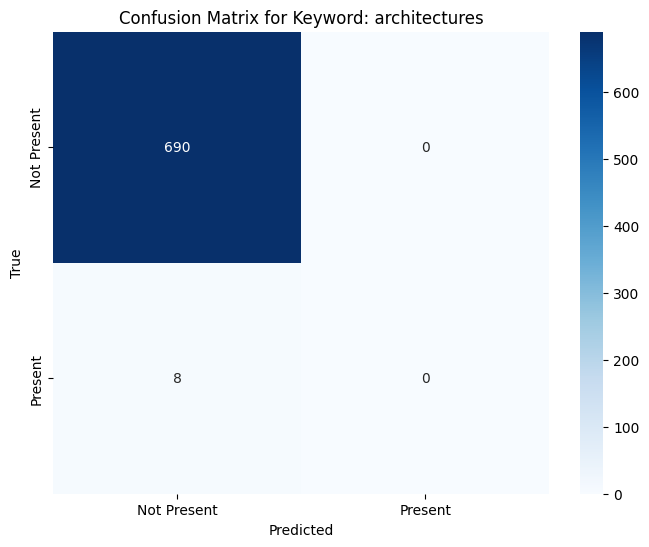

...

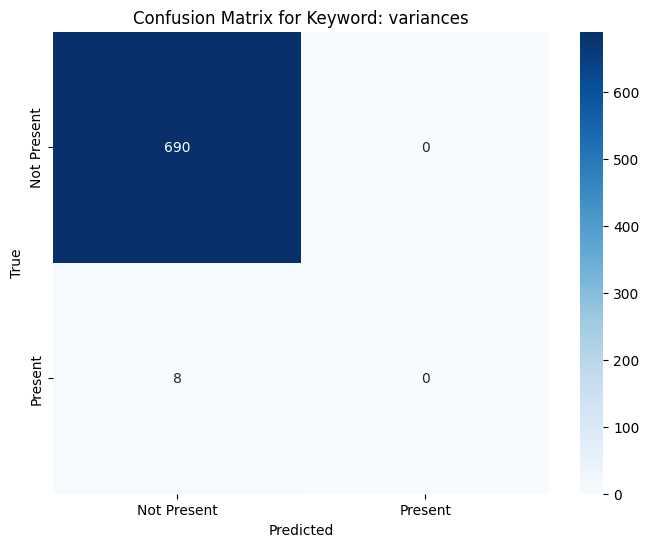

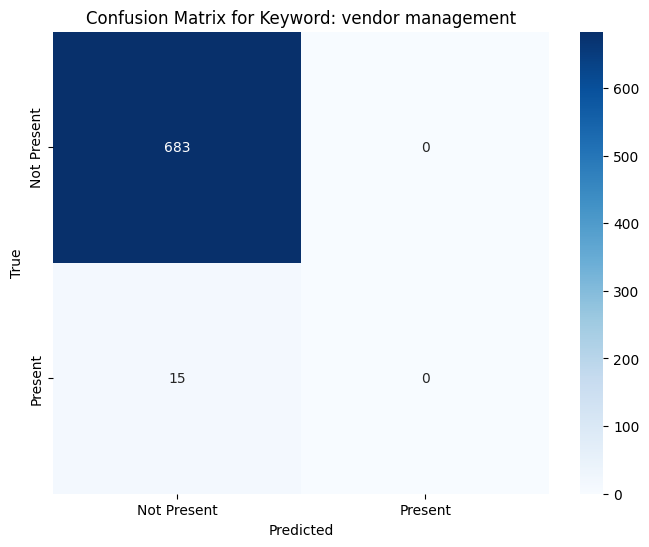

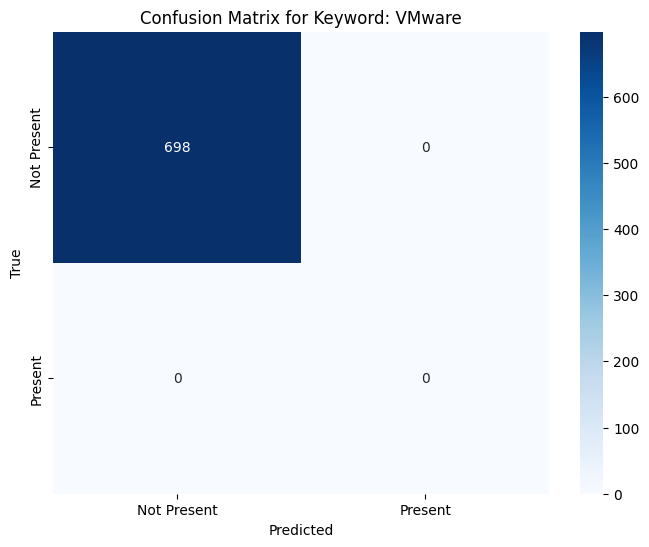

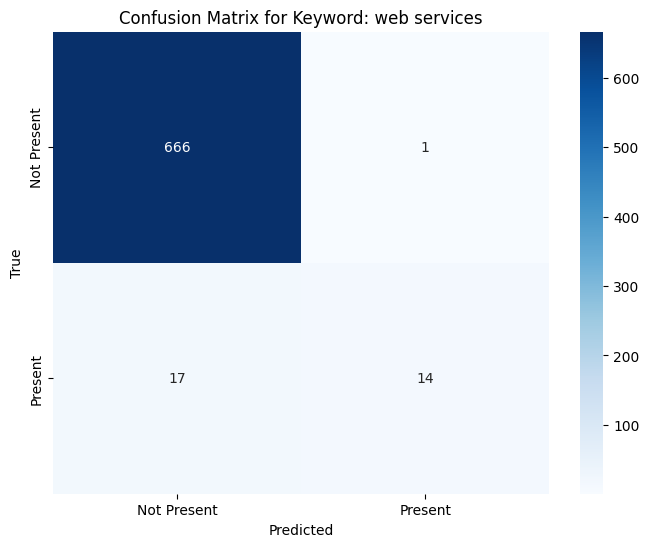

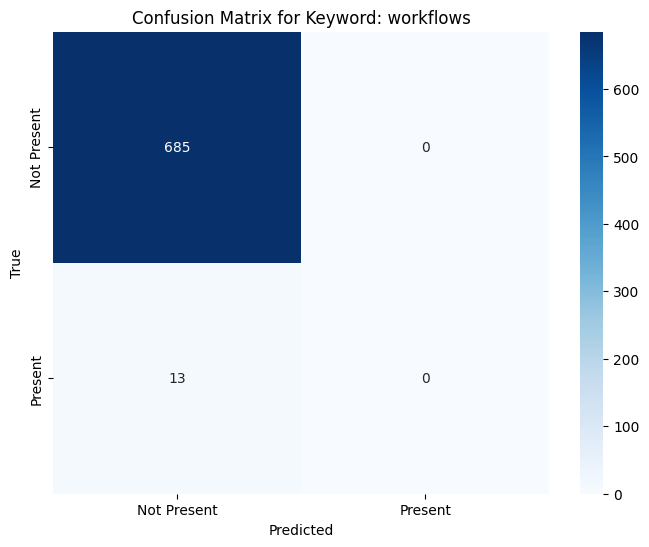

In [58]:
def plot_confusion_matrix(cm, keyword):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=['Not Present', 'Present'],
                yticklabels=['Not Present', 'Present'])
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'Confusion Matrix for Keyword: {keyword}')
    plt.show()

# Plot confusion matrices for each keyword
for i, (conf_matrix, keyword) in enumerate(zip(conf_matrices, keywords)):
    plot_confusion_matrix(conf_matrix, keyword)

##Evaluating the model

In [59]:
model_18.evaluate(X_test, y_test)

22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.1183 - loss: 0.0940


[0.09654755890369415, 0.0916905477643013]

##Model 19 doubling the number of LSTM modules, 5 epochs

In [61]:
model_19 = Sequential([
    Embedding(input_dim=input_dim, output_dim=128),
    Bidirectional(LSTM(128, return_sequences=True)),
    Dropout(0.5),
    Bidirectional(LSTM(128)),
    Dense(64, activation = 'relu'),
    Dense(123, activation = 'sigmoid')
    ])


##Compiling model

In [62]:
model_19.compile(
    loss = 'binary_crossentropy',
    optimizer = 'adam',
    metrics = ['accuracy']
)

##Training and saving the model

In [63]:
history_model_19 = model_19.fit(
    X_train, y_train,
    epochs = 5,
    batch_size=32,
    validation_data=(X_val, y_val),
    verbose=0
)

#Saving the model
model_19.save('model_19.keras')
with open('history_model_19.json', 'w') as f:
    json.dump(history_model_19.history, f)

##Model summary

In [64]:
model_19.summary()

Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding_6 (Embedding)              │ (None, 1000, 128)           │       5,120,000 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_12 (Bidirectional)     │ (None, 1000, 256)           │         263,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_6 (Dropout)                  │ (None, 1000, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_13 (Bidirectional)     │ (None, 256)                 │         394,240 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_12 (Dense)                     │ (None, 64)                  │          16,448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_13 (Dense)                     │ (None, 123)                 │           7,995 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 17,405,555 (66.40 MB)

 Trainable params: 5,801,851 (22.13 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 11,603,704 (44.26 MB)

##Reloading model

In [65]:
model_19 = tf.keras.models.load_model('model_19.keras')
with open('history_model_19.json') as f:
    history_model_19 = json.load(f)

##Plotting the training

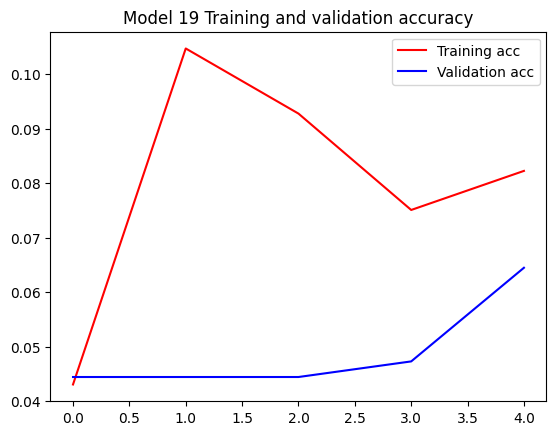

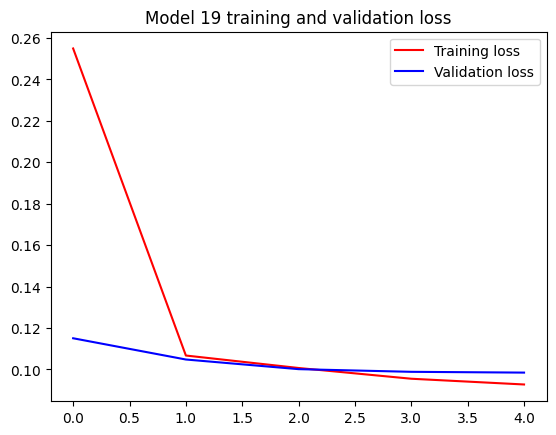

In [66]:
acc = history_model_19['accuracy']
val_acc = history_model_19['val_accuracy']
loss = history_model_19['loss']
val_loss = history_model_19['val_loss']

epochs = range(len(acc))


plt.plot(epochs, acc, 'r', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Model 19 Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Model 19 training and validation loss')
plt.legend()

plt.show()

##Predictions

In [67]:
y_pred_prob = model_19.predict(X_test)
threshold = 0.85
y_pred = (y_pred_prob > threshold).astype(int)

22/22 ━━━━━━━━━━━━━━━━━━━━ 3s 90ms/step


##Calculating the matrix

In [69]:
# Compute confusion matrices for each class
conf_matrices = multilabel_confusion_matrix(y_test, y_pred)

# Print confusion matrices
for i, conf_matrix in enumerate(conf_matrices):
    print(f"Confusion Matrix for Keyword {i}:")
    print(conf_matrix)
    print()

Confusion Matrix for Keyword 0:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 1:
[[689   0]
 [  9   0]]

Confusion Matrix for Keyword 2:
[[678   0]
 [ 20   0]]

Confusion Matrix for Keyword 3:
[[634   0]
 [ 64   0]]

Confusion Matrix for Keyword 4:
[[690   0]
 [  8   0]]

Confusion Matrix for Keyword 5:
[[688   0]
 [ 10   0]]

Confusion Matrix for Keyword 6:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 7:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 8:
[[688   0]
 [ 10   0]]

Confusion Matrix for Keyword 9:
[[685   0]
 [ 13   0]]

Confusion Matrix for Keyword 10:
[[695   0]
 [  3   0]]

Confusion Matrix for Keyword 11:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 12:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 13:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 14:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 15:
[[588   0]
 [110   0]]

Confusion Matrix for Keyword 16:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 17:
[[664   

##Visualising the matrix

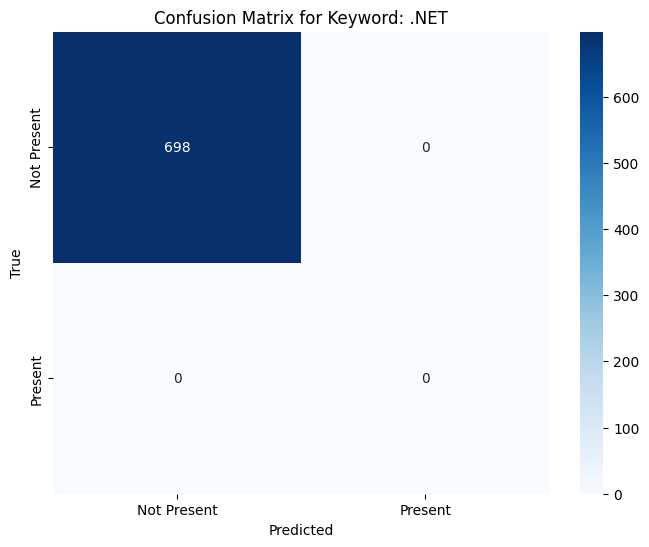

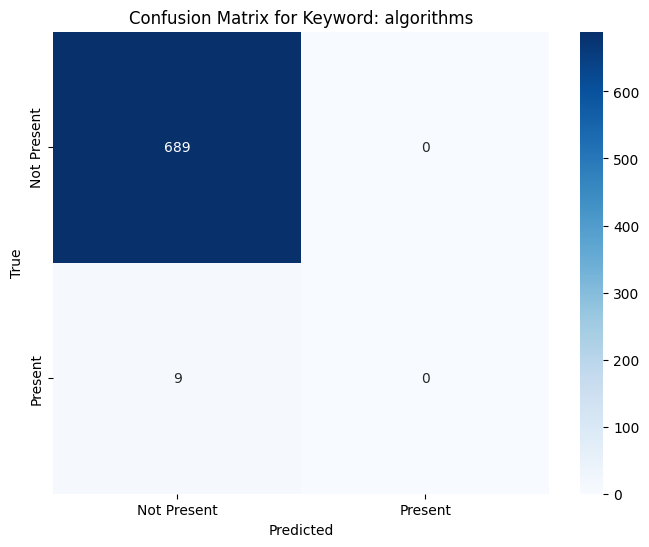

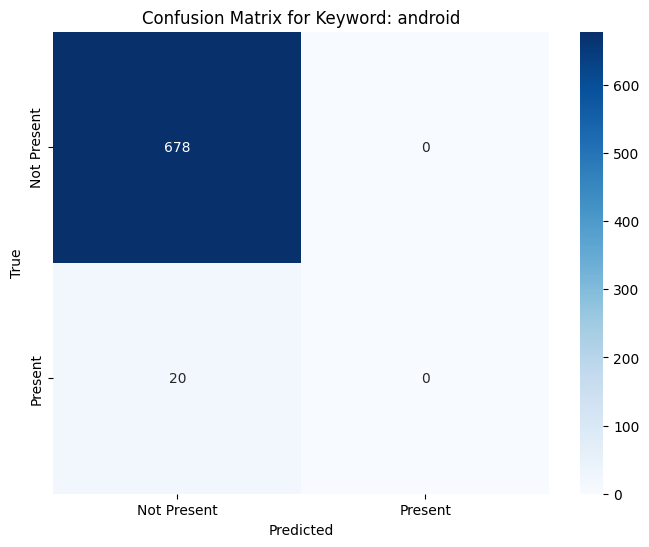

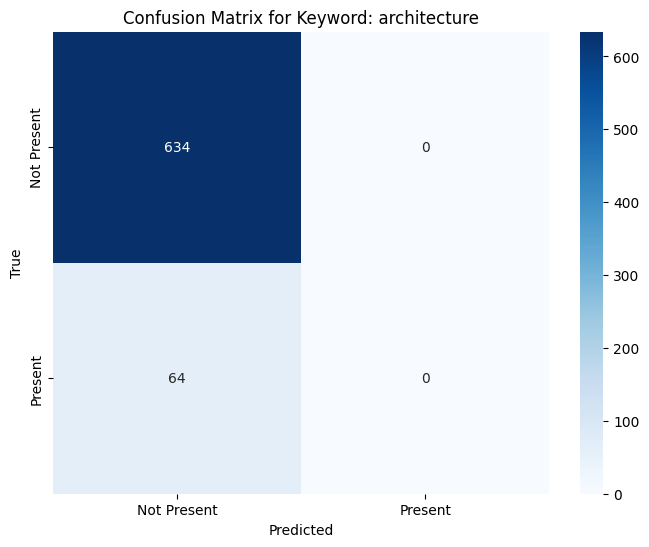

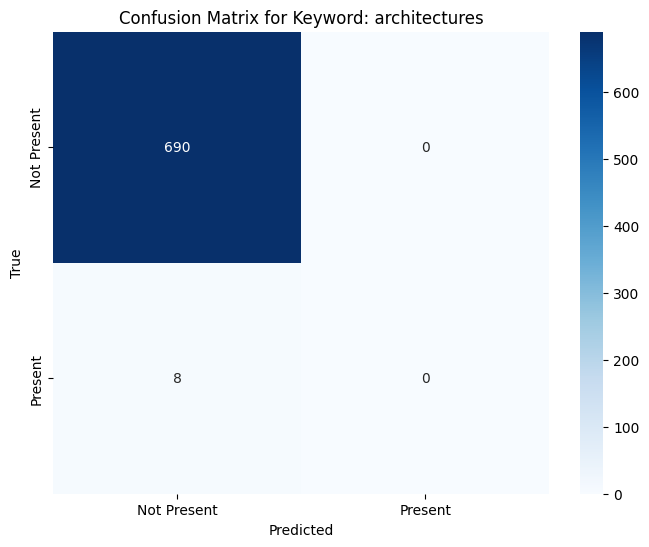

...

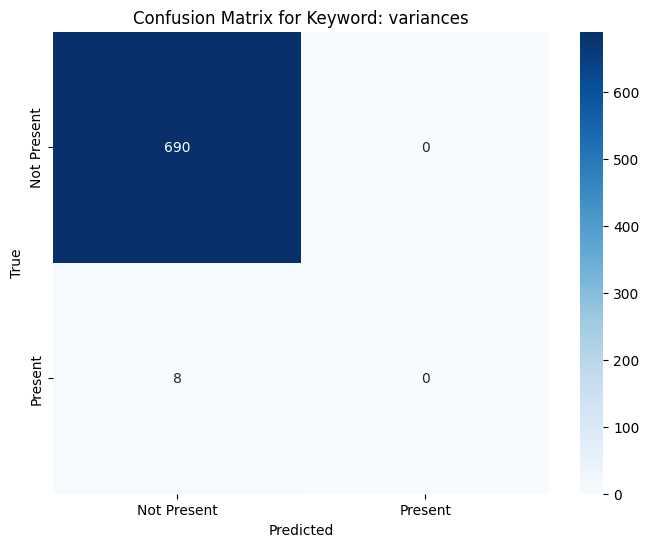

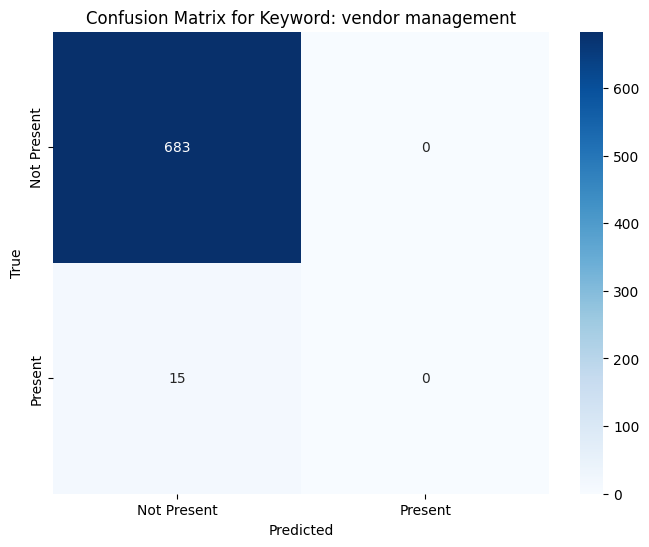

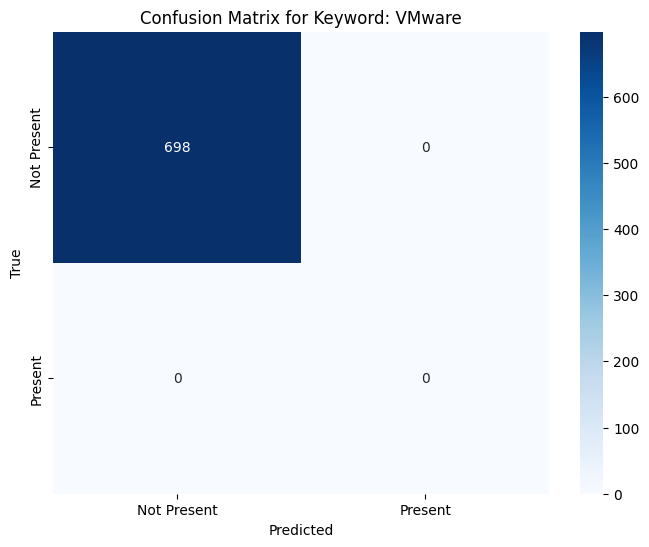

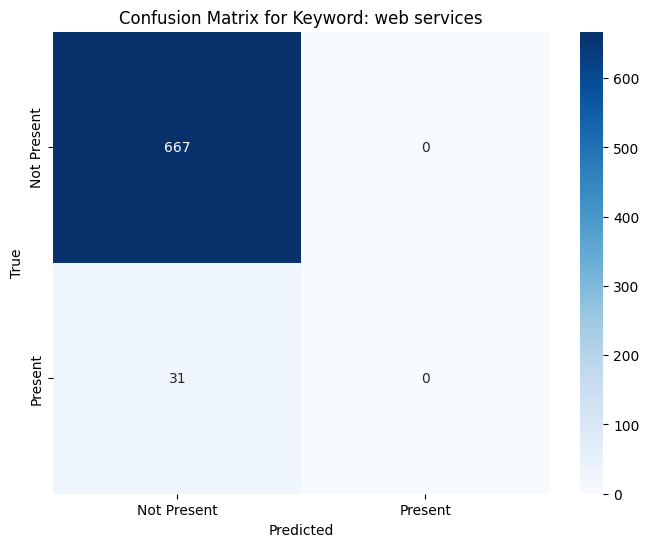

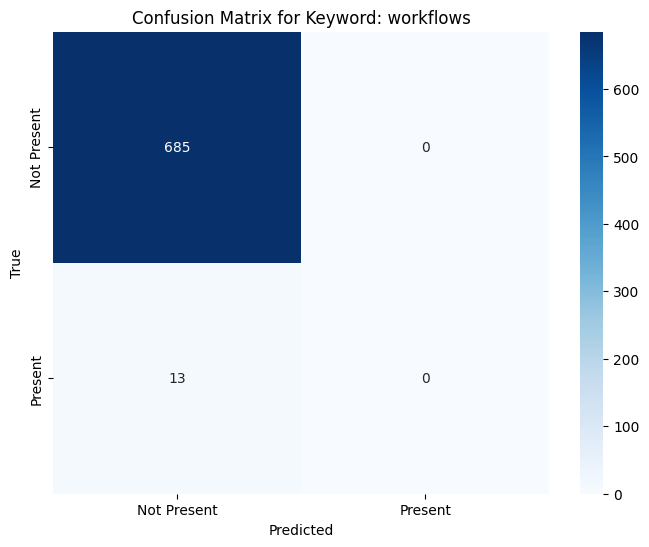

In [70]:
def plot_confusion_matrix(cm, keyword):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=['Not Present', 'Present'],
                yticklabels=['Not Present', 'Present'])
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'Confusion Matrix for Keyword: {keyword}')
    plt.show()

# Plot confusion matrices for each keyword
for i, (conf_matrix, keyword) in enumerate(zip(conf_matrices, keywords)):
    plot_confusion_matrix(conf_matrix, keyword)

##Evaluating the model

In [71]:
model_19.evaluate(X_test, y_test)

22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step - accuracy: 0.0679 - loss: 0.1001


[0.10097377747297287, 0.05300859734416008]

##Model 20 128 LSTM and 40 epochs

In [72]:
model_20 = Sequential([
    Embedding(input_dim=input_dim, output_dim=128),
    Bidirectional(LSTM(128, return_sequences=True)),
    Dropout(0.5),
    Bidirectional(LSTM(128)),
    Dense(64, activation = 'relu'),
    Dense(123, activation = 'sigmoid')
    ])


##Compiling the model

In [73]:
model_20.compile(
    loss = 'binary_crossentropy',
    optimizer = 'adam',
    metrics = ['accuracy']
)

##Training and saving the model

In [74]:
history_model_20 = model_20.fit(
    X_train, y_train,
    epochs = 40,
    batch_size=32,
    validation_data=(X_val, y_val),
    verbose=0
)

#Saving the model
model_20.save('model_20.keras')
with open('history_model_20.json', 'w') as f:
    json.dump(history_model_20.history, f)

##Model summary

In [75]:
model_20.summary()

Model: "sequential_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding_7 (Embedding)              │ (None, 1000, 128)           │       5,120,000 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_14 (Bidirectional)     │ (None, 1000, 256)           │         263,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_7 (Dropout)                  │ (None, 1000, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_15 (Bidirectional)     │ (None, 256)                 │         394,240 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_14 (Dense)                     │ (None, 64)                  │          16,448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_15 (Dense)                     │ (None, 123)                 │           7,995 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 17,405,555 (66.40 MB)

 Trainable params: 5,801,851 (22.13 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 11,603,704 (44.26 MB)

##Reloading the model

In [76]:
model_20 = tf.keras.models.load_model('model_20.keras')
with open('history_model_20.json') as f:
    history_model_20 = json.load(f)

##Plotting the training

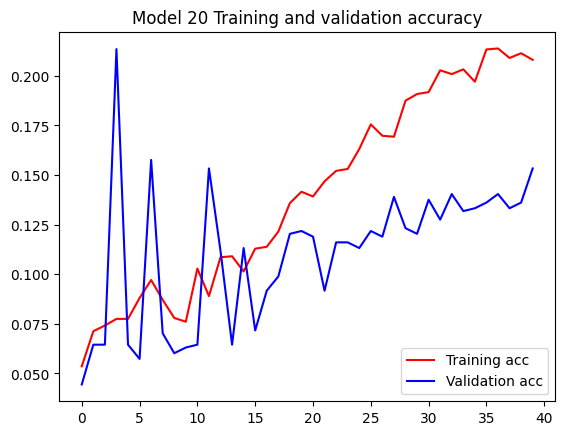

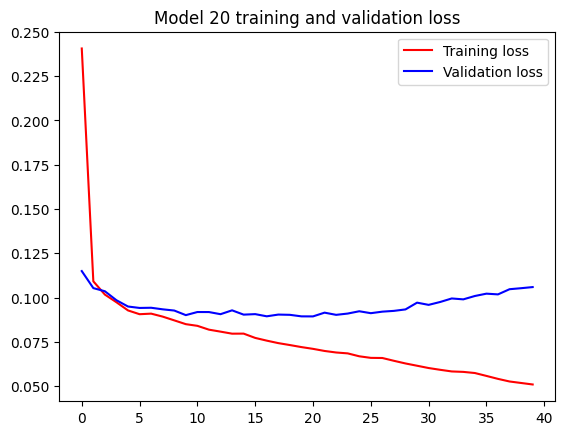

In [77]:
acc = history_model_20['accuracy']
val_acc = history_model_20['val_accuracy']
loss = history_model_20['loss']
val_loss = history_model_20['val_loss']

epochs = range(len(acc))


plt.plot(epochs, acc, 'r', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Model 20 Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Model 20 training and validation loss')
plt.legend()

plt.show()

##Predictions

In [78]:
y_pred_prob = model_20.predict(X_test)
threshold = 0.85
y_pred = (y_pred_prob > threshold).astype(int)

22/22 ━━━━━━━━━━━━━━━━━━━━ 3s 96ms/step


##Calculating the matrix

In [79]:
# Compute confusion matrices for each class
conf_matrices = multilabel_confusion_matrix(y_test, y_pred)

# Print confusion matrices
for i, conf_matrix in enumerate(conf_matrices):
    print(f"Confusion Matrix for Keyword {i}:")
    print(conf_matrix)
    print()

Confusion Matrix for Keyword 0:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 1:
[[689   0]
 [  9   0]]

Confusion Matrix for Keyword 2:
[[678   0]
 [ 20   0]]

Confusion Matrix for Keyword 3:
[[628   6]
 [ 38  26]]

Confusion Matrix for Keyword 4:
[[690   0]
 [  8   0]]

Confusion Matrix for Keyword 5:
[[688   0]
 [ 10   0]]

Confusion Matrix for Keyword 6:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 7:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 8:
[[688   0]
 [ 10   0]]

Confusion Matrix for Keyword 9:
[[683   2]
 [ 13   0]]

Confusion Matrix for Keyword 10:
[[695   0]
 [  3   0]]

Confusion Matrix for Keyword 11:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 12:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 13:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 14:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 15:
[[585   3]
 [109   1]]

Confusion Matrix for Keyword 16:
[[698   0]
 [  0   0]]

Confusion Matrix for Keyword 17:
[[664   

##Visualising the matrix

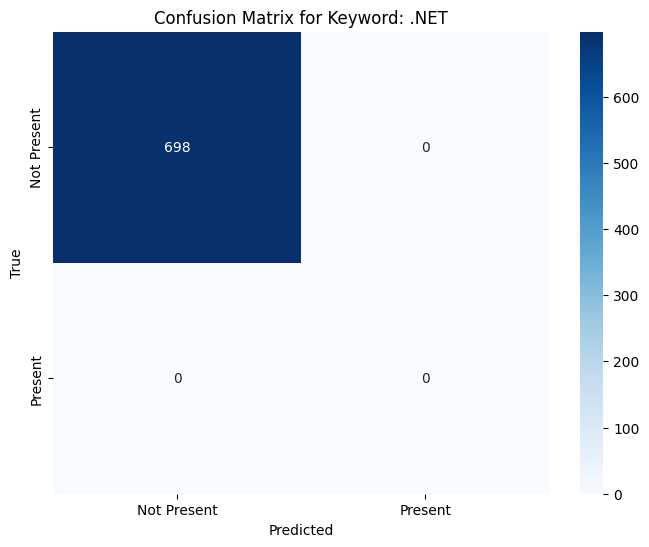

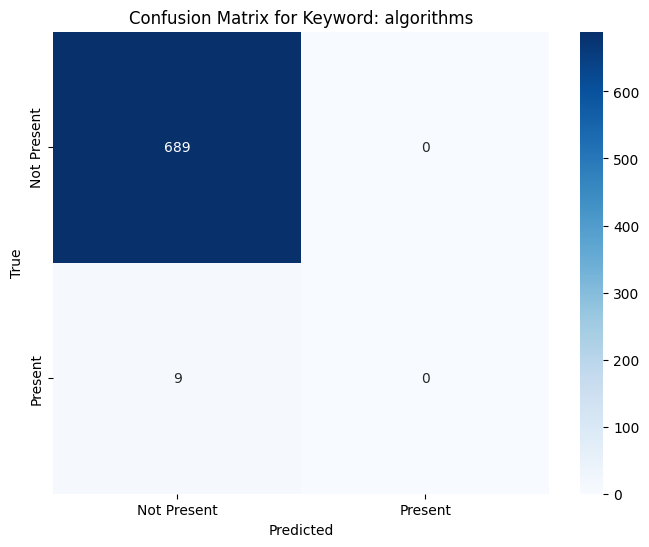

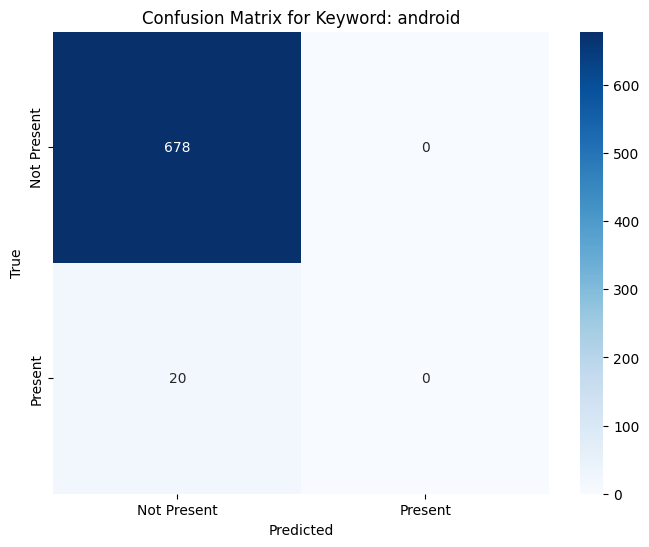

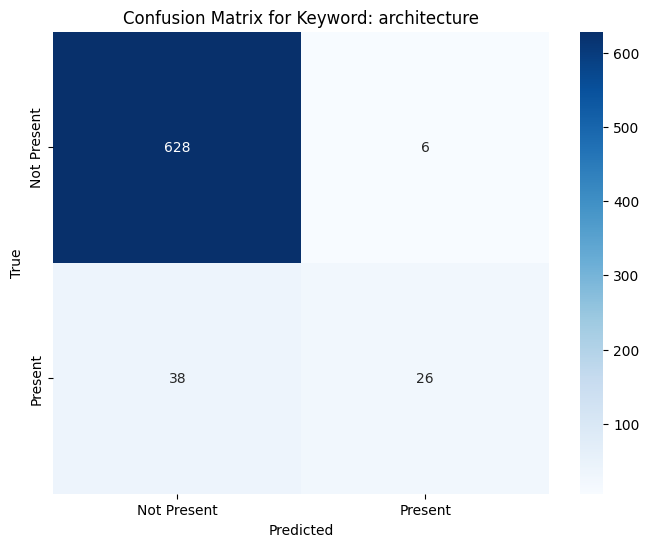

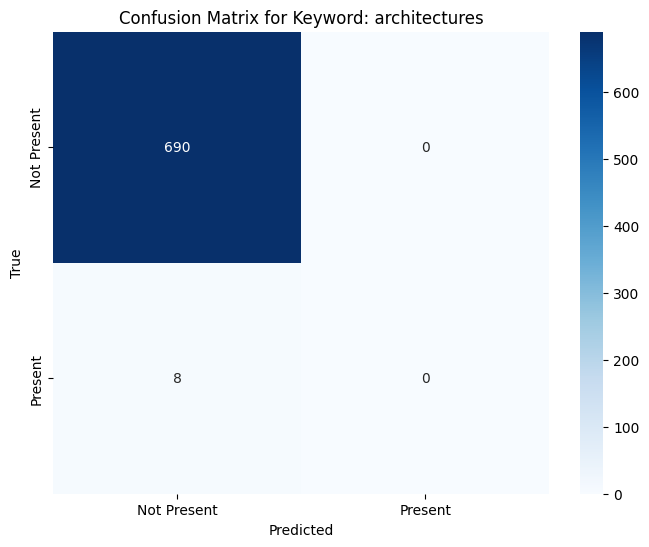

...

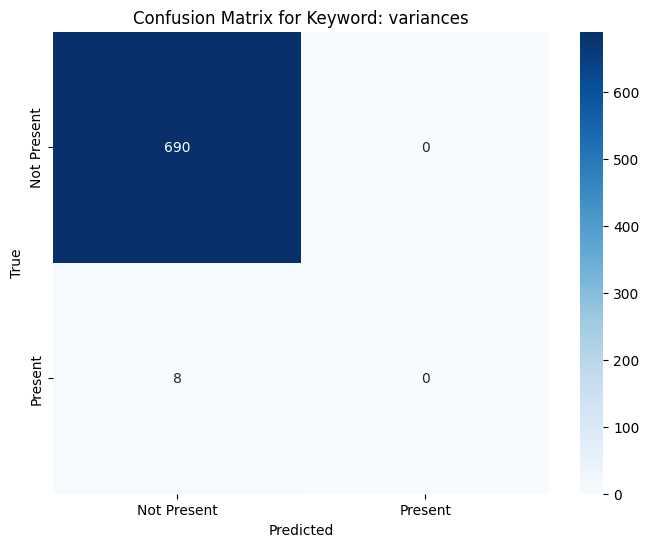

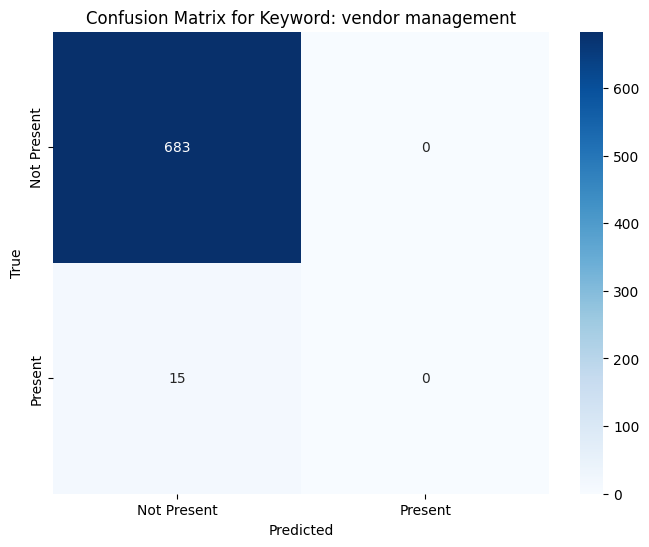

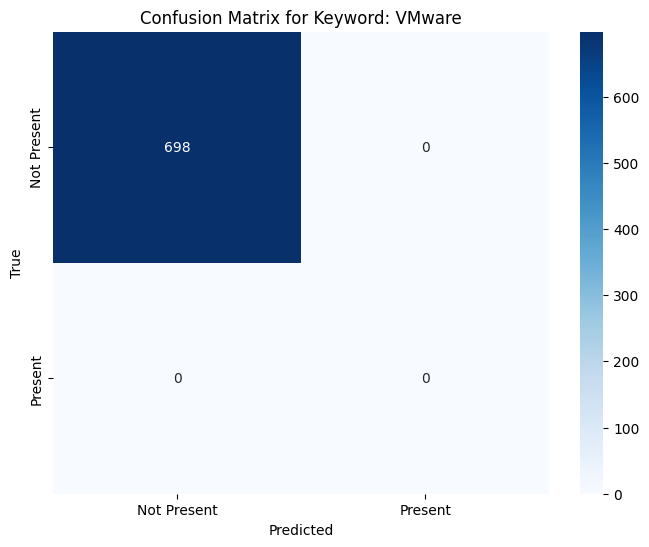

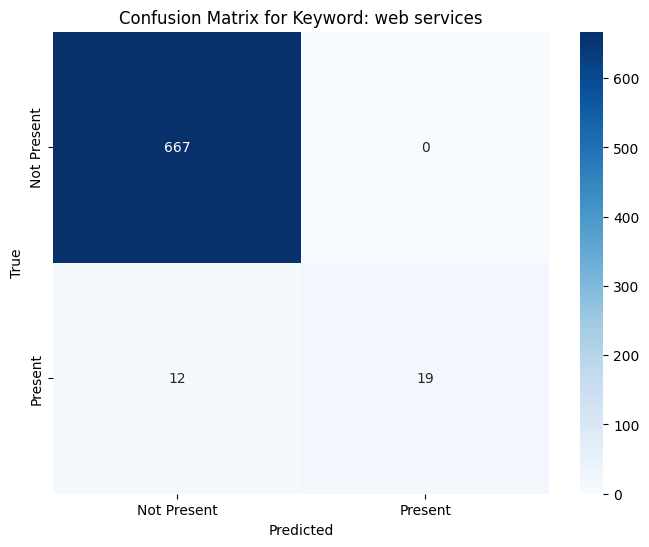

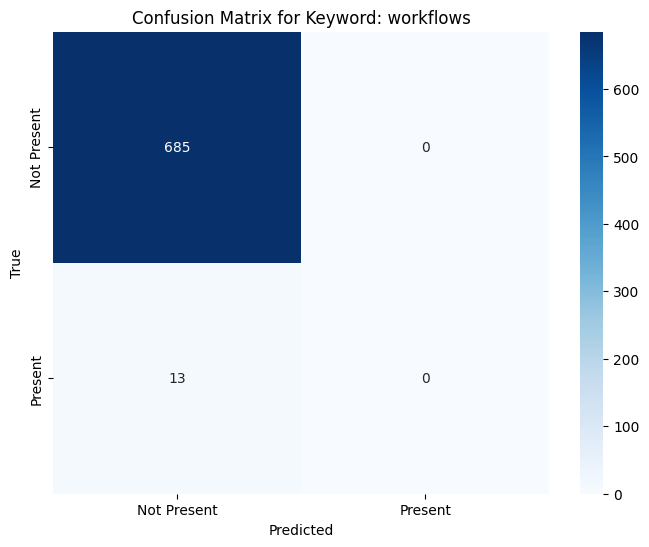

In [80]:
def plot_confusion_matrix(cm, keyword):
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=['Not Present', 'Present'],
                yticklabels=['Not Present', 'Present'])
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title(f'Confusion Matrix for Keyword: {keyword}')
    plt.show()

# Plot confusion matrices for each keyword
for i, (conf_matrix, keyword) in enumerate(zip(conf_matrices, keywords)):
    plot_confusion_matrix(conf_matrix, keyword)

##Evaluating the model

In [81]:
model_20.evaluate(X_test, y_test)

22/22 ━━━━━━━━━━━━━━━━━━━━ 6s 111ms/step - accuracy: 0.1262 - loss: 0.1089


[0.10923870652914047, 0.12464183568954468]